In [ ]:
from elastic_nerf.utils import wandb_utils as wu
from pathlib import Path
import pandas as pd
from IPython.display import display
from collections import defaultdict
import math
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from dataclasses import asdict
import torch
from tqdm import tqdm as tqdm
import numpy as np
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib.colors import LogNorm, Normalize, BoundaryNorm
from matplotlib import colormaps as colormaps
from matplotlib.colors import ListedColormap


class ColorConfig:
    def __init__(self):
        self.set3_cmap = plt.get_cmap("Set2")
        self.colors = [self.set3_cmap(i) for i in range(7)]
        self.cmap = ListedColormap(self.colors)
        self.buckets = np.array([0, 1, 2, 4, 8, 16, 32, 64])
        self.norm = BoundaryNorm(self.buckets, len(self.buckets))

    def get_color(self, width):
        return self.cmap(self.norm(width))

    def get_colorbar(self, ax):
        cb = plt.colorbar(
            cm.ScalarMappable(cmap=self.cmap, norm=self.norm),
            ticks=self.buckets,
            format="%.0f",
            ax=ax,
        )
        cb.ax.minorticks_off()
        return cb


sweep_mappings = {
    # "2uxektzo": "ngp_occ-mipnerf360-baseline",
    # "kebumdc0": "ngp_occ-mipnerf360-baseline",
    # "xxjsfkbw": "ngp_prop-mipnerf360-baseline",
    # "8w0wks0x": "ngp_prop-mipnerf360-baseline",
    # "qfkjdvv2": "ngp_occ-mipnerf360-sampling_single",
    # "hy03dx0e": "ngp_occ-mipnerf360-sampling",
    # "wsxh6gjo": "ngp_prop-mipnerf360-sampling",
    # "8ishbvau": "ngp_prop-mipnerf360-sampling_single",
    # "b674pjcs": "ngp_occ-mipnerf360-baseline_head_depth1",
    # "58hgroe5": "ngp_prop-mipnerf360-baseline_head_depth1",
    # "c6g1mc5g": "ngp_occ-mipnerf360-baseline-mup",
    # "ccrwhsr5": "ngp_prop-mipnerf360-baseline-mup",
    "2gc9i1ze": "ngp_prop-mipnerf360-baseline-granular_norm",
}

NB_NAME="tr1f_mup_baseline_granular_norm"

# TR1f_mUP_Baseline_GranularNorm
Recall that in `tr1e_mup_baseline_propv2`, we found that the training dynamics didn't quite follow the consistent spectral norm scaling predicted by optimal training with mup. Assuming mUP is correct, this implies that we're missing some necessary ingredients. My hypothesis is that it works well or "out of the box" with transformers because they have normalization layers built in. So in this experiment, we attempt to retrain the baseline Nerfacc Prop models on a few scenes by adding in a _GranularNorm_ layer after each hidden layer in both the proposal networks and the Radiance Field (both base MLP and head MLP). Like before, we experiment with head MLPs of depth 2 and 1. Since we're only training the baseline (i.e. fixed width), there's nothing really Granular about our norm, in a fixed width setting it essentially becomes a LayerNorm instead. The interesting question is if we need a norm after every hidden layer or if we can get away with just having norms in the radiance field and not in the proposal networks. An even more interesting question is if we can replace the learnt normalization parameters with something based on mUP's recommendation for scaling. This might make the backward pass slightly faster/less complicated. An even more interesting question is what the normalization scaling factors end up being after training. Do they/can they converge to the recommended scaling factors from mUP?

### Hypotheses:
1. GranularNorm will positively impact performance
2. GranularNorm will negatively impact training speed
3. GranularNorm scaling factors will converge to the ratios recommended by mUP
4. There will be less variance among random seeds after applying the GranularNorm
5. GranularNorm will result in constrained norms which scale more "correctly"

## Issues
Wait if Matformer did it in Jax, then their LayerNorm must have been "elastic" too right?
- **NOPE**. In their implementation, the norm comes after the hidden layers

We must figure out why the norms right after initialization vary so wildly between seeds. This implies that it's not actually getting the std we want. **We need to debug this!! Perhaps we can pre-generate the weights for each layer such that we guarantee it's good, and then just load those in instead of calling the init functions**

In [ ]:
tables = ["EvalResultsSummarytable"]
sweeps = sweep_mappings.keys()
results_cache_dir = Path("/home/user/shared/results/elastic-nerf")
sweep_results = {}

for sweep in sweeps:
    sweep_results[sweep] = wu.fetch_sweep_results(
        sweep=sweep,
        refresh_sweep_cache=False,
        refresh_run_cache=False,
        download_history=True,
        tables=tables,
    )
all_history = []
# Create a dataframe with all the results
for sweep_name in sweep_results:
    for run in sweep_results[sweep_name]:
        # Flatten the config
        flat_config = wu.flatten_dict(run.config, sep="-")
        # Concatenate the config with each row of the history results
        # Note that history results are already a dataframe
        history = run.history
        history["sweep_id"] = sweep_name
        history["run_id"] = run.run_id
        history["model_type"] = (
            "Nerfacc Prop" if "prop" in sweep_mappings[sweep_name] else "Nerfacc Occ"
        )
        history["sweep_name"] = sweep_mappings[sweep_name]
        for key in flat_config:
            try:
                history[key] = str(flat_config[key])
            except:
                print(f"Failed to add {key} to history with value {flat_config[key]}")
                raise
        all_history.append(history)

# %%
# Concatenate all the history results into a single dataframe
final_df = pd.concat(all_history, ignore_index=True)


# %%

fp = f"results_{NB_NAME}.csv"
final_df.to_csv(fp, index=False)
print(f"Saved results to {fp}")
df = pd.read_csv(fp)

(gonas) [WARNING] Loading cached results for sweep 2gc9i1ze
/tmp/ipykernel_1215636/3360067825.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  history[key] = str(flat_config[key])
/tmp/ipykernel_1215636/3360067825.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  history[key] = str(flat_config[key])
/tmp/ipykernel_1215636/3360067825.py:31: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once u

Saved results to results_tr1f_mup_baseline_granular_norm.csv


# Results
## Sampling Strategy
First, let's take a look at the average results across 3 random seeds. Why are the results for Stump so awful all the time??

In [ ]:
num_scenes = len(df["scene"].unique())
table_cols = ["Head Depth", "Scene", "Width 64", "Width 32", "Width 16", "Width 8"]
for i, (model_type, model_group) in enumerate(df.groupby(by="model_type")):
    model_group = model_group.query("_step == 20000")
    for k, (head_depth, head_depth_group) in enumerate(
        model_group.groupby(by="radiance_field-head_depth")
    ):
        table_data = []
        for j, (scene, scene_group) in enumerate(head_depth_group.groupby(by="scene")):
            base_psnr = model_group.query(
                "_step == 20000 and hidden_dim == 64 and scene == @scene and `radiance_field-head_depth` == 2"
            )["Eval Results Summary/psnr_avg/elastic_64"].median()
            table_row = {"Scene": scene.capitalize(), "Head Depth": f"{head_depth}"}
            for dim, dim_group in scene_group.groupby(by="hidden_dim"):
                psnr_col = f"Eval Results Summary/psnr_avg/elastic_{dim}"
                psnr_avg = dim_group[psnr_col].median()
                psnr_std = dim_group[psnr_col].std()
                pc_diff = 100 * (psnr_avg - base_psnr) / base_psnr
                if dim == 64 and head_depth == 2:
                    table_row.update({f"Width {dim}": f"{psnr_avg:.2f}±{psnr_std:.2f}"})
                else:
                    table_row.update(
                        {
                            f"Width {dim}": f"{psnr_avg:.2f}±{psnr_std:.2f} ({pc_diff:.2f}%)"
                        }
                    )
            table_data.append(table_row)

        table_data = pd.DataFrame(table_data, columns=table_cols)
        caption = (
            f"PSNR values after 20k steps of training for {model_type} model (with Radiance Field head MLP depth = {head_depth}) at different widths across scenes from the MipNeRF-360 dataset."
            f"  Values in brackets are the percentage difference compared to the baseline PSNR for each model at full-size (width 64) and Radiance Field Head MLP depth 2 (default model)."
        )
        table_data = table_data.style.set_caption(caption)
        display(table_data)
    # print(
    #     table_data.to_latex(
    #         index=False,
    #         caption=f"Baseline performance (PSNR) after 20k steps of training for {model_type_name} model at different widths across scenes from the MipNeRF-360 dataset",
    #         label=f"tab:baseline_{model_type_name.replace(' ', '_')}",
    #         position="h",
    #         column_format="lcccccc",
    #         escape=True,
    #         bold_rows=True,
    #     )
    # )

,Head Depth,Scene,Width 64,Width 32,Width 16,Width 8
0,1,Counter,27.13±0.08 (-0.73%),26.92±0.06 (-1.52%),26.30±0.11 (-3.77%),25.54±0.13 (-6.57%)
1,1,Garden,25.25±0.11 (-0.12%),25.14±0.06 (-0.56%),24.84±0.06 (-1.76%),24.47±0.20 (-3.23%)
2,1,Kitchen,30.21±0.10 (-0.94%),29.90±0.09 (-1.97%),28.99±0.04 (-4.95%),27.88±0.30 (-8.60%)
3,1,Stump,25.21±0.02 (-0.22%),25.04±4.97 (-0.91%),24.83±0.06 (-1.75%),24.03±0.33 (-4.91%)


,Head Depth,Scene,Width 64,Width 32,Width 16,Width 8
0,2,Counter,27.33±0.20,27.04±0.14 (-1.08%),26.36±0.21 (-3.56%),25.54±0.04 (-6.56%)
1,2,Garden,25.28±0.09,25.20±0.03 (-0.34%),24.96±0.05 (-1.26%),24.30±0.15 (-3.88%)
2,2,Kitchen,30.50±0.13,30.04±0.09 (-1.51%),29.48±0.20 (-3.33%),28.01±0.23 (-8.16%)
3,2,Stump,25.27±4.93,24.94±4.19 (-1.29%),24.87±5.18 (-1.56%),24.03±0.33 (-4.91%)


# LaTeX table for Head Depth 2

In [ ]:
num_scenes = len(df["scene"].unique())
table_cols = ["Scene", "Width 64", "Width 32", "Width 16", "Width 8"]

header_row1 = [
    "\multicolumn{4}{c}{NGP Occ} & \\multicolumn{4}{c}{NGP Prop} \\\\",
]
header_row2 = [
    "\\textbf{Scene}",
    "Width 64",
    "Width 32",
    "Width 16",
    "Width 8",
    "Width 64",
    "Width 32",
    "Width 16",
    "Width 8",
]
header = (
    " & ".join(header_row1)
    + " \\midrule \n"
    + " & ".join(header_row2)
    + " \\\\ \\midrule"
)

table_data = []

base_psnrs = defaultdict(dict)
for j, (scene, scene_group) in enumerate(df.groupby(by="scene")):
    table_row = ["\\textbf{" + scene.capitalize() + "}"]  # Scene names in bold
    for i, (model_type, model_group) in enumerate(scene_group.groupby(by="model_type")):
        model_group = model_group.query("_step == 20000")
        model_group = model_group[model_group["radiance_field-head_depth"] == 2]
        base_psnr = model_group.query("hidden_dim == 64")[
            "Eval Results Summary/psnr_avg/elastic_64"
        ].mean()
        base_psnrs[scene][model_type] = base_psnr
        for dim in [64, 32, 16, 8]:
            dim_group = model_group.query(f"hidden_dim == {dim}")
            psnr_col = f"Eval Results Summary/psnr_avg/elastic_{dim}"
            psnr_avg = dim_group[psnr_col].mean()
            psnr_std = dim_group[psnr_col].std()
            pc_diff = 100 * (psnr_avg - base_psnr) / base_psnr
            if dim == 64:
                table_row.append(f"{psnr_avg:.2f}±{psnr_std:.2f}")
            else:
                table_row.append(f"{psnr_avg:.2f}±{psnr_std:.2f} ({pc_diff:.1f}\\%)")
    table_data.append(table_row)

# Converting the Python list of lists to a LaTeX table
table_body = " \\\\\n".join([" & ".join(row) for row in table_data]) + " \\\\"

# Combining the header and body to form the final table
final_table = (
    "\\begin{table*}[h]\n\\centering\n\\small\n"
    "\\caption{Combined Baseline PSNR after 20k steps of training optimally with mUP for NGP Occ and NGP Prop models (with depth of 2 for the Radiance Field head MLP) at different widths across scenes from the MipNeRF-360 dataset}\n"
    "\\label{tab:combined_baseline_NGP}\n"
    "\\begin{tabular}{lcccc|cccc}\n\\toprule\n"
    + header
    + "\n"
    + table_body
    + "\n\\bottomrule\n"
    "\\end{tabular}\n\\end{table*}"
)
print(final_table)

\begin{table*}[h]
\centering
\small
\caption{Combined Baseline PSNR after 20k steps of training optimally with mUP for NGP Occ and NGP Prop models (with depth of 2 for the Radiance Field head MLP) at different widths across scenes from the MipNeRF-360 dataset}
\label{tab:combined_baseline_NGP}
\begin{tabular}{lcccc|cccc}
\toprule
\multicolumn{4}{c}{NGP Occ} & \multicolumn{4}{c}{NGP Prop} \\ \midrule 
\textbf{Scene} & Width 64 & Width 32 & Width 16 & Width 8 & Width 64 & Width 32 & Width 16 & Width 8 \\ \midrule
\textbf{Counter} & 27.31±0.20 & 27.06±0.14 (-0.9\%) & 26.41±0.21 (-3.3\%) & 25.53±0.04 (-6.5\%) \\
\textbf{Garden} & 25.33±0.09 & 25.21±0.03 (-0.5\%) & 24.94±0.05 (-1.5\%) & 24.32±0.15 (-4.0\%) \\
\textbf{Kitchen} & 30.53±0.13 & 30.02±0.09 (-1.7\%) & 29.37±0.20 (-3.8\%) & 27.99±0.23 (-8.3\%) \\
\textbf{Stump} & 22.43±4.93 & 22.58±4.19 (0.6\%) & 21.94±5.18 (-2.2\%) & 24.09±0.33 (7.4\%) \\
\bottomrule
\end{tabular}
\end{table*}


# LaTeX table for Head Depth 1

In [ ]:
num_scenes = len(df["scene"].unique())
table_cols = ["Scene", "Width 64", "Width 32", "Width 16", "Width 8"]

header_row1 = [
    "\multicolumn{4}{c}{NGP Occ} & \\multicolumn{4}{c}{NGP Prop} \\\\",
]
header_row2 = [
    "\\textbf{Scene}",
    "Width 64",
    "Width 32",
    "Width 16",
    "Width 8",
    "Width 64",
    "Width 32",
    "Width 16",
    "Width 8",
]
header = (
    " & ".join(header_row1)
    + " \\midrule \n"
    + " & ".join(header_row2)
    + " \\\\ \\midrule"
)

table_data = []

base_psnrs = defaultdict(dict)
for j, (scene, scene_group) in enumerate(df.groupby(by="scene")):
    table_row = ["\\textbf{" + scene.capitalize() + "}"]  # Scene names in bold
    for i, (model_type, model_group) in enumerate(scene_group.groupby(by="model_type")):
        model_group = model_group.query("_step == 20000")
        model_group = model_group[model_group["radiance_field-head_depth"] == 1]
        base_psnr = model_group.query("hidden_dim == 64")[
            "Eval Results Summary/psnr_avg/elastic_64"
        ].mean()
        base_psnrs[scene][model_type] = base_psnr
        for dim in [64, 32, 16, 8]:
            dim_group = model_group.query(f"hidden_dim == {dim}")
            psnr_col = f"Eval Results Summary/psnr_avg/elastic_{dim}"
            psnr_avg = dim_group[psnr_col].mean()
            psnr_std = dim_group[psnr_col].std()
            pc_diff = 100 * (psnr_avg - base_psnr) / base_psnr
            if dim == 64:
                table_row.append(f"{psnr_avg:.2f}±{psnr_std:.2f}")
            else:
                table_row.append(f"{psnr_avg:.2f}±{psnr_std:.2f} ({pc_diff:.1f}\\%)")
    table_data.append(table_row)

# Converting the Python list of lists to a LaTeX table
table_body = " \\\\\n".join([" & ".join(row) for row in table_data]) + " \\\\"

# Combining the header and body to form the final table
final_table = (
    "\\begin{table*}[h]\n\\centering\n\\small\n"
    "\\caption{Combined Baseline PSNR after 20k steps of training optimally with mUP for NGP Occ and NGP Prop models (with depth of 1 for the Radiance Field head MLP) at different widths across scenes from the MipNeRF-360 dataset}\n"
    "\\label{tab:combined_baseline_NGP}\n"
    "\\begin{tabular}{lcccc|cccc}\n\\toprule\n"
    + header
    + "\n"
    + table_body
    + "\n\\bottomrule\n"
    "\\end{tabular}\n\\end{table*}"
)
print(final_table)

\begin{table*}[h]
\centering
\small
\caption{Combined Baseline PSNR after 20k steps of training optimally with mUP for NGP Occ and NGP Prop models (with depth of 1 for the Radiance Field head MLP) at different widths across scenes from the MipNeRF-360 dataset}
\label{tab:combined_baseline_NGP}
\begin{tabular}{lcccc|cccc}
\toprule
\multicolumn{4}{c}{NGP Occ} & \multicolumn{4}{c}{NGP Prop} \\ \midrule 
\textbf{Scene} & Width 64 & Width 32 & Width 16 & Width 8 & Width 64 & Width 32 & Width 16 & Width 8 \\ \midrule
\textbf{Counter} & 27.17±0.08 & 26.90±0.06 (-1.0\%) & 26.36±0.11 (-3.0\%) & 25.48±0.13 (-6.2\%) \\
\textbf{Garden} & 25.20±0.11 & 25.16±0.06 (-0.2\%) & 24.86±0.06 (-1.4\%) & 24.52±0.20 (-2.7\%) \\
\textbf{Kitchen} & 30.18±0.10 & 29.91±0.09 (-0.9\%) & 29.00±0.04 (-3.9\%) & 28.01±0.30 (-7.2\%) \\
\textbf{Stump} & 25.22±0.02 & 22.18±4.97 (-12.1\%) & 24.85±0.06 (-1.5\%) & 24.21±0.33 (-4.0\%) \\
\bottomrule
\end{tabular}
\end{table*}


# Exploring the results from the perspective of Maximal Update Parameterization

Previously during our initial explorations into mUP, we arrived at the following conclusions for a simple MLP with 2 hidden layers:
### Layer 1
Init variance:
- Target variance is 0.5, target std is 0.7, actual variance approaches 0.5 as n→inf
- Standard xavier normal initialization has std which seems to scale as $\sqrt{\frac{2}{fanin + fanout}}$ 
	- So as fanout → inf (this is our width), std gets smaller and smaller
	- Instead, mup says that it should only scale as a function of `1/fan_in` (which for us scales O(1)) so we end up with a constant init var for input weight across all widths. **Thus we set target variance to 0.5**
	- Under the hood, mup multiplies the standard scale by $\sqrt{\frac{fanout + fanin}{fanoutBase + faninBase}}$
		- $\therefore \sqrt{\frac{2}{fanin + fanout}} \cdot \sqrt{\frac{fanout + fanin}{fanoutBase + faninBase}}$
		- $\sqrt{\frac{2}{3 + fanout}} \cdot \sqrt{\frac{fanout + 3}{1 + 3}} = \sqrt{\frac{2}{4}} = \sqrt{0.5}$
		- $\therefore Var = \sigma^{2} = 0.5$
Multiplier:
- `fan_in.width_mult` scales constantly O(1)
- but the shape’s width_mult seems to scale linearly? _O(n)_?
Learning rate:
- LR scales constantly O(1) (**so same as global LR**) for **Adam**

### Layer 2 (Hidden Layer)
Init variance:
- Xavier initialization by default scales init variance scale as $\sqrt{\frac{2}{fanin + fanout}}$ 
- But mup first scales the usual std by $\sqrt{\frac{fanout + fanin}{fanoutBase + faninBase}}$
	- and then for weights with 2 infinite dimensions (i.e. hidden layer weights where both fanin and fanout are infinite), it additionally divides it by $\sqrt{faninWidthMult}$
	- $\therefore \sqrt{\frac{2}{fanin + fanout}} \cdot \sqrt{\frac{fanout + fanin}{fanoutBase + faninBase}} / \sqrt{faninWidthMult}$
	- Note that in our case, we have a square matrix so `fanin.dim == fanout.dim == width`. Also `fan_in.width_mult() == width` since our base network was “pure” with `width==1`
	- $\therefore \sqrt{\frac{2}{width + width}} \cdot \sqrt{\frac{width + width}{1 + 1}} \cdot \frac{1}{\sqrt{faninWidthMult}} =  \frac{1}{\sqrt{faninWidthMult}}$
	- Note that this ends up being the same as the default initialization because $\sqrt{\frac{2}{fanin + fanout}} = \sqrt{\frac{1}{width}} = \sqrt{\frac{1}{faninWidthMult}}$ 
	- **This doesn’t match up with Table 8 which says for hidden weights, init variance scales `1/fan_in`?**

Multiplier:
- both `fan_in.width_mult()` and `width_mult` scale linearly O(n)? But then why does **Table 8 say the multiplier is 1?**

Learning Rate:
- We set the global learning rate to 0.1
- mup Adam scales the global lr by $\frac{1}{fanin}$ (or in the code, divides the `group['lr'] /= width_mult)
- This matches up with all the tables which say for hidden weights, scale the global LR by $lr = gLR \cdot \frac{1}{fanin}$ 

### Readout (Output Layer)
Init variance:
- Recall that mup scales the usual std by
  
$$\sqrt{\frac{fanout + fanin}{fanoutBase + faninBase}}$$

Thus, we get:

$$\sqrt{\frac{2}{fanin + fanout}} \cdot \sqrt{\frac{fanout + fanin}{fanoutBase + faninBase}}$$
 
$$= \sqrt{\frac{2}{width + 16}} \cdot \sqrt{\frac{16 + width}{16 + 1}} = \sqrt{\frac{2}{fanout +1}} = \sqrt{\frac{2}{17}}$$
 
- This matches up with Table 

## Training Dynamics

Let's take a look at the training dynamics for the width 64 baseline models after training them with mUP. Specifically, we want to see if the spectral norm scaling stays constant as the width increases (as they claim it should).

In [ ]:
def make_df_for_run(
    weight_norms, grad_norms, config, model_type, steps, sweep_id, run_id
):
    results_all = []
    num_steps = 43
    num_widths = config.hidden_dim
    module_names = list(weight_norms.keys())
    flattened_config = wu.flatten_dict(asdict(config), sep=".")
    for step_idx in range(num_steps):
        base_width = 8
        for width_idx in range(num_widths):
            for module_name in module_names:
                try:
                    results = {
                        "step": steps[step_idx],
                        "width": width_idx + 1,
                        "module": module_name,
                        "sweep_id": sweep_id,
                        "run_id": run_id,
                        "model_type": model_type,
                    }
                    results.update(flattened_config)
                    for metric_type in [
                        "L1",
                        "Frobenius",
                        "Spectral (max)",
                        "Spectral (min)",
                    ]:
                        if (
                            len(weight_norms[module_name][metric_type]["1D"][step_idx])
                            < num_widths
                        ):
                            # If the module wasn't elastic, we don't compute the norms for it
                            weight = None
                            weight_scaled = None
                            print(
                                f"Weight norms for {module_name} at step {step_idx} are missing elements, found {len(weight_norms[module_name][metric_type]['1D'][step_idx])} but expected {num_widths}"
                            )
                        else:
                            weight = weight_norms[module_name][metric_type]["1D"][
                                step_idx
                            ][width_idx]
                            base_weight = weight_norms[module_name][metric_type]["1D"][
                                step_idx
                            ][base_width - 1]

                            weight_scaled = (
                                weight / base_weight if base_weight > 0 else None
                            )

                        if (
                            step_idx == 0
                            or len(
                                grad_norms[module_name][metric_type]["1D"][step_idx - 1]
                            )
                            < num_widths
                        ):
                            grad = None
                            grad_scaled = None
                        else:
                            grad = grad_norms[module_name][metric_type]["1D"][
                                step_idx - 1
                            ][width_idx]
                            grad_base = grad_norms[module_name][metric_type]["1D"][
                                step_idx - 1
                            ][base_width - 1]
                            grad_scaled = grad / grad_base if grad_base > 0 else None
                        results.update(
                            {
                                f"weight/{metric_type}": weight,
                                f"weight_scaled/{metric_type}": weight_scaled,
                                f"grad/{metric_type}": grad,
                                f"grad_scaled/{metric_type}": grad_scaled,
                            }
                        )
                    results_all.append(results)
                except Exception as e:
                    print(
                        f"Encountered error at step {step_idx}, width {width_idx}, metric {metric_type} for {module_name}: {e}"
                    )
                    raise e

    return pd.DataFrame(results_all)


log_dir = Path("/home/user/shared/results/elastic-nerf")
wandb_dir = Path("/home/user/shared/wandb_cache/elastic-nerf")
results_cache_dir = Path("/home/user/shared/results/elastic-nerf")

COMPUTE_TRAINING_DYNAMICS_DF = False
if COMPUTE_TRAINING_DYNAMICS_DF:
    dfs = []
    for sweep_id in sweep_mappings.keys():
        sweep = wu.fetch_sweep(sweep_id)
        for run in tqdm(sweep.runs):
            training_dynamics_path = (
                results_cache_dir / run.id / "weights_grads/training_dynamics.pt"
            )
            training_dynamics = torch.load(training_dynamics_path)
            weight_norms = training_dynamics["weight_norms"]
            grad_norms = training_dynamics["grad_norms"]
            steps = training_dynamics["training_steps"]
            config = training_dynamics["config"]
            model_type = training_dynamics["model_type"]
            try:
                df = make_df_for_run(
                    weight_norms,
                    grad_norms,
                    config,
                    model_type,
                    steps,
                    sweep_id,
                    run.id,
                )
                dfs.append(df)
            except Exception as e:
                print(f"Failed to process run {run.id} from sweep {sweep_id}: {e}")

    df = pd.concat(dfs)
    df.to_csv(f"{NB_NAME}_training_dynamics.csv", index=False)
    cols = [
        "seed",
        "step",
        "width",
        "module",
        "sampling_strategy",
        "loss_weight_strategy",
        "radiance_field.use_elastic",
        "radiance_field.use_elastic_head",
        "radiance_field.head_depth",
        "density_field.use_elastic",
        "num_widths_to_sample",
        "model_type",
        "num_train_widths",
        "duplicate_train_batch_across_widths",
        "run_id",
        "sweep_id",
        "dataset.scene",
        "hidden_dim",
        "adjust_lr_for_duplicate_train_batch",
        "max_steps",
        "num_eval_elastic_widths",
        "fused_eval",
        "host_machine",
        "weight/L1",
        "weight_scaled/L1",
        "grad/L1",
        "grad_scaled/L1",
        "weight/Frobenius",
        "weight_scaled/Frobenius",
        "grad/Frobenius",
        "grad_scaled/Frobenius",
        "weight/Spectral (max)",
        "weight_scaled/Spectral (max)",
        "grad/Spectral (max)",
        "grad_scaled/Spectral (max)",
        "weight/Spectral (min)",
        "weight_scaled/Spectral (min)",
        "grad/Spectral (min)",
        "grad_scaled/Spectral (min)",
    ]
    df[cols].to_csv(f"{NB_NAME}_training_dynamics_filtered.csv", index=False)
else:
    df = pd.read_csv(f"{NB_NAME}_training_dynamics_filtered.csv")

  0%|                                                                                                  | 0/96 [00:00<?, ?it/s]2024-04-03 20:03:51.778414: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-03 20:03:51.820190: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-03 20:03:51.984494: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-03 20:03:52.829059: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
100%|█████████████████████████████████████████████████████████████████████████████████████████| 96/96 [03:28<00:00,  2.17s/it]


In [ ]:
for scene, scene_group in df.groupby(by="dataset.scene"):
    for model_type, model_type_group in scene_group.groupby(by="model_type"):
        for head_depth, head_depth_group in model_type_group.groupby(
            by="radiance_field.head_depth"
        ):
            for hidden_dim, hidden_dim_group in head_depth_group.groupby(
                by="hidden_dim"
            ):
                for module, module_group in hidden_dim_group.groupby(by="module"):
                    pass

As expected, **the scaled norms do not provide any useful information in this case, since we're scaling with respect to the base width (of 8) which was never explicitly optimized**. Instead, the scale ratios we expect should be obtained by comparing against the training dynamics of a baseline width 8 model (one with hidden dim 8, not just one where we splice a layer width of 8). However, note that between different seeds, the width 64 training dynamics are somewhat consistent in shape. I think it would be useful to visualize just the width 64 norm across steps. Basically in each plot, we want to see the width 64 metric for all 3 seeds, each subplot should show a different metric, and each subfigure should show a different module.

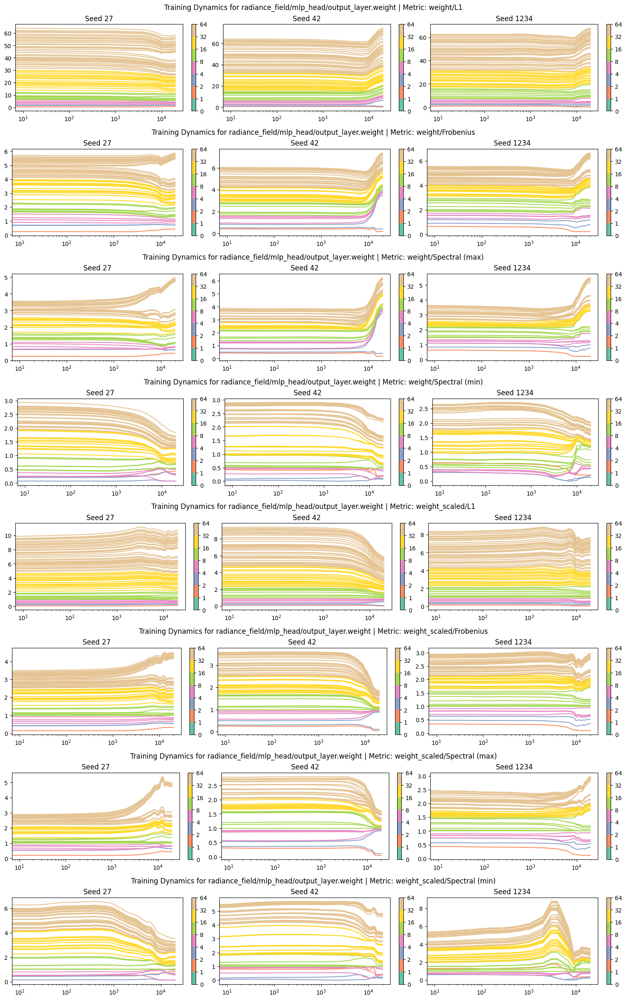

In [ ]:
cc = ColorConfig()
metric_types = [
    "weight/L1",
    "weight/Frobenius",
    "weight/Spectral (max)",
    "weight/Spectral (min)",
    "weight_scaled/L1",
    "weight_scaled/Frobenius",
    "weight_scaled/Spectral (max)",
    "weight_scaled/Spectral (min)",
]
fig = plt.figure(layout="constrained", figsize=(15, 3 * len(metric_types)))
subfigs = fig.subfigures(len(metric_types), 1, wspace=0.07)
for i, metric_type in enumerate(metric_types):
    subfig = subfigs[i]
    subfig.suptitle(f"Training Dynamics for {module} | Metric: {metric_type}")
    subplots = subfig.subplots(1, len(module_group["seed"].unique()))
    for j, (seed, seed_group) in enumerate(module_group.groupby(by="seed")):
        ax = subplots[j]
        for width, width_group in seed_group.groupby(by="width"):
            color = cc.get_color(width)
            ax.plot(width_group["step"], width_group[f"{metric_type}"], color=color)
        ax.set_xscale("log")
        ax.set_title(f"Seed {seed}")
        cc.get_colorbar(ax)

### Issues
Why is the training dynamics for the proposal_net_0 constant? Is this why we found that the grads were 0? Maybe it's not getting optimized for some reason??

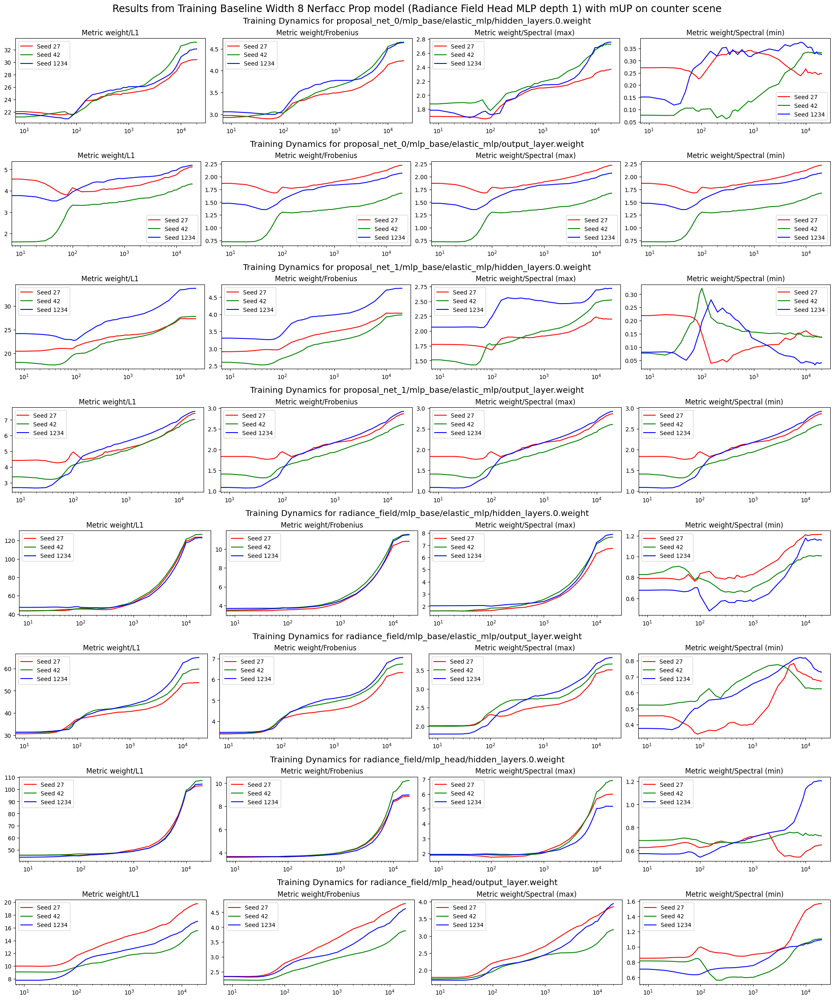

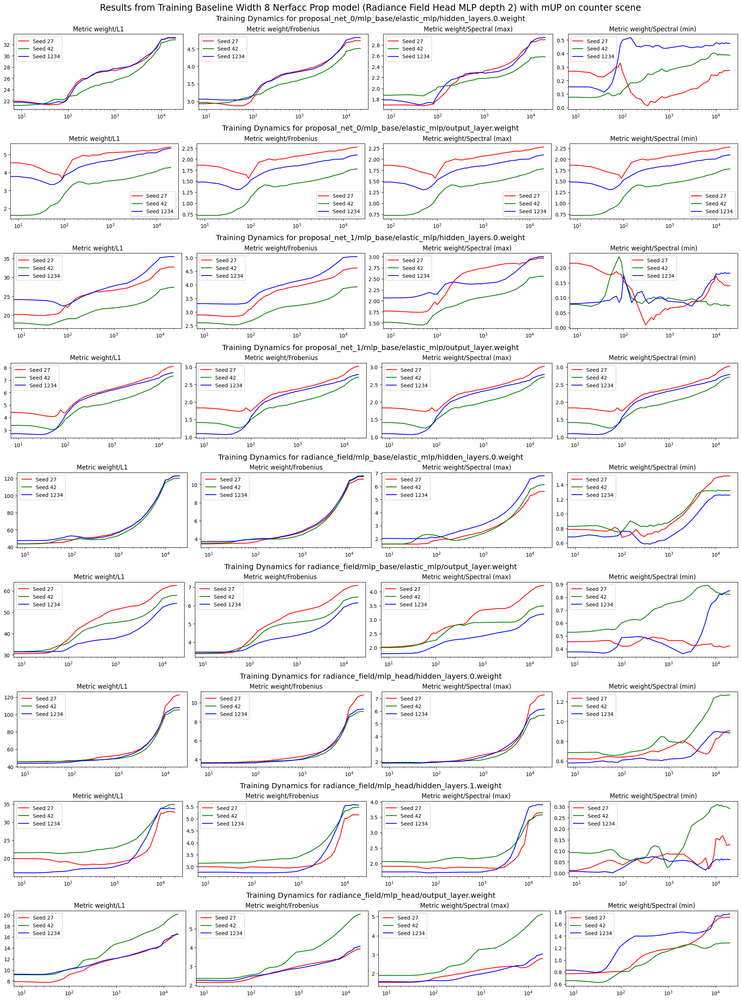

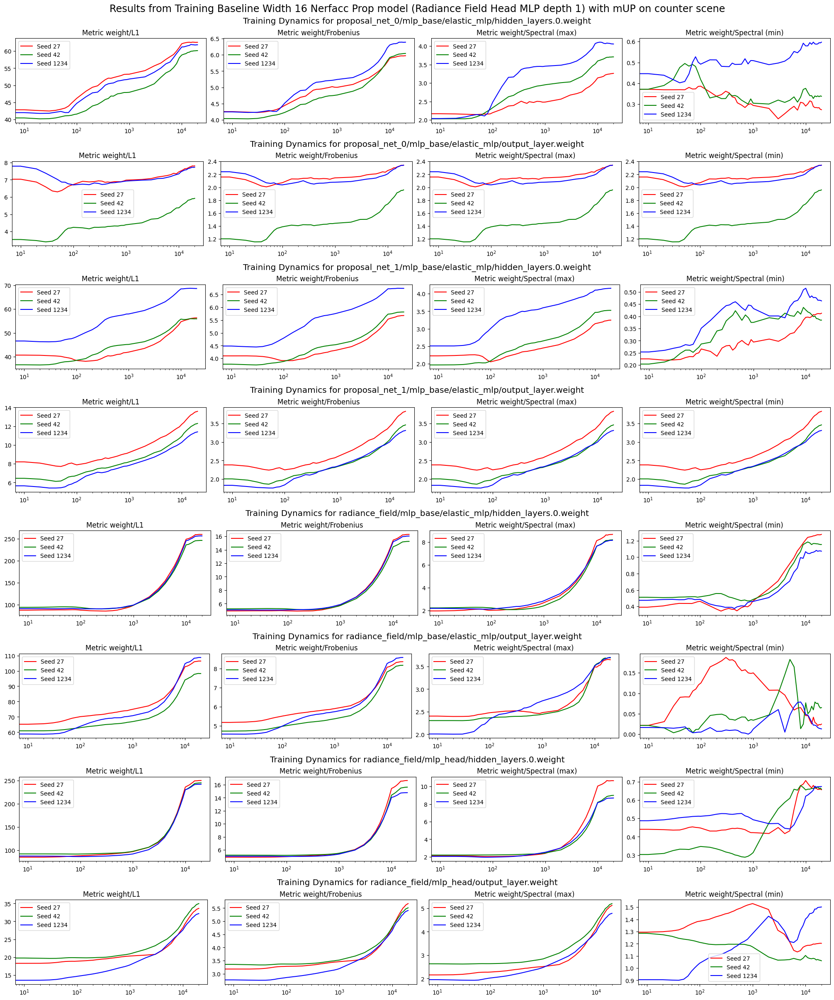

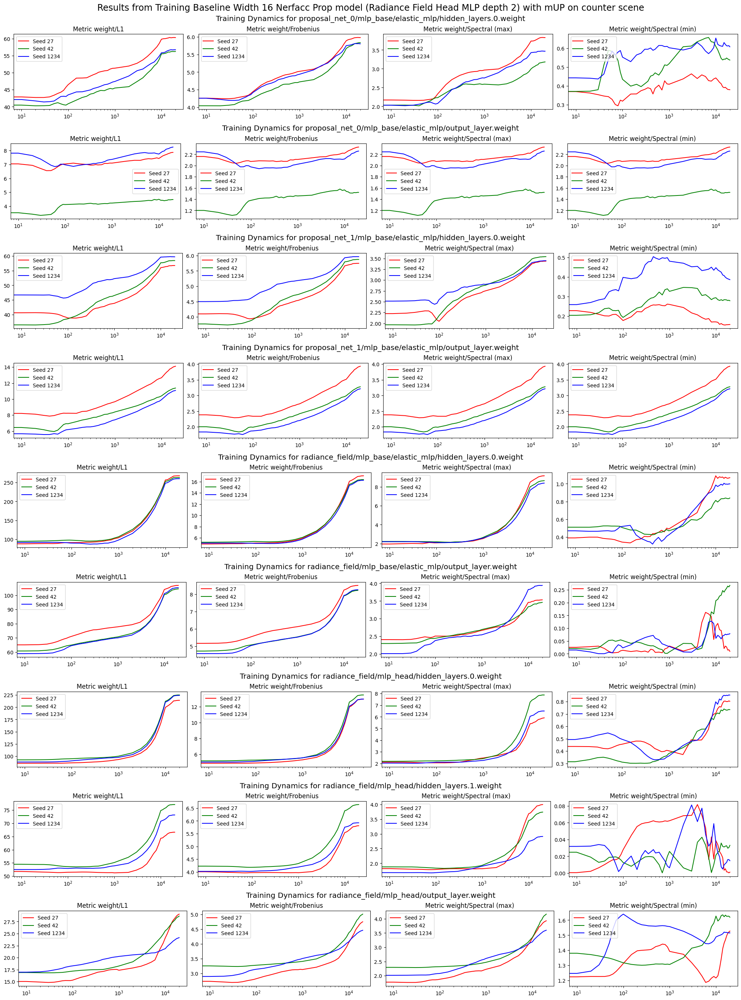

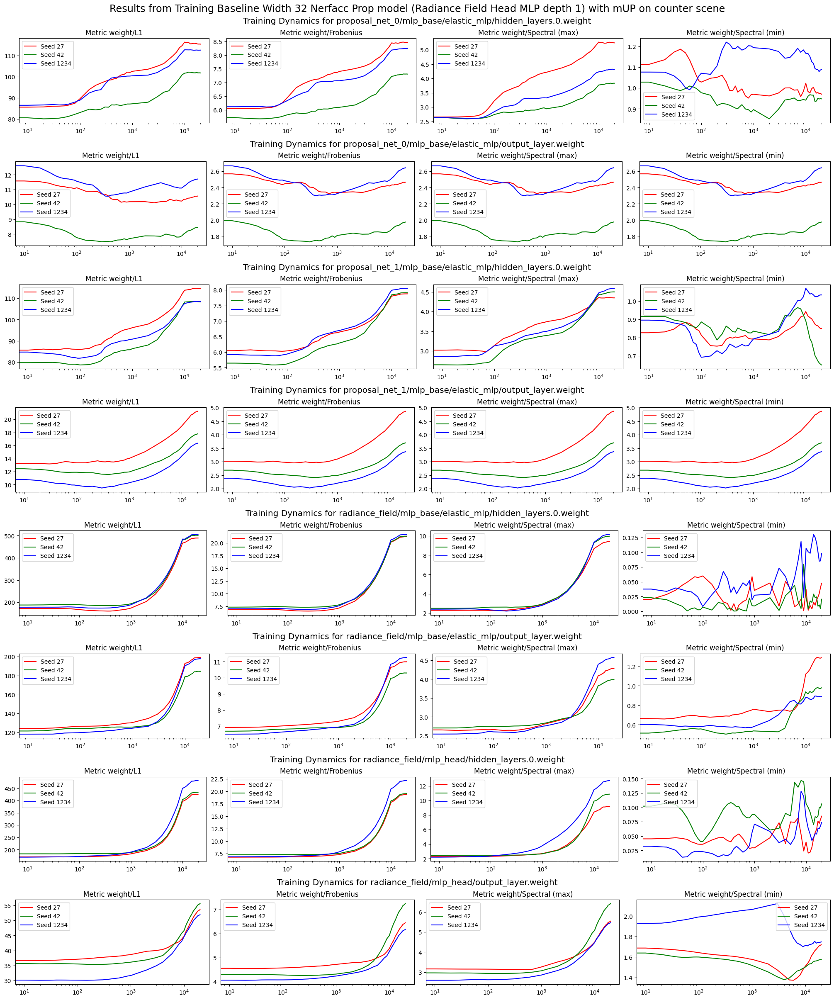

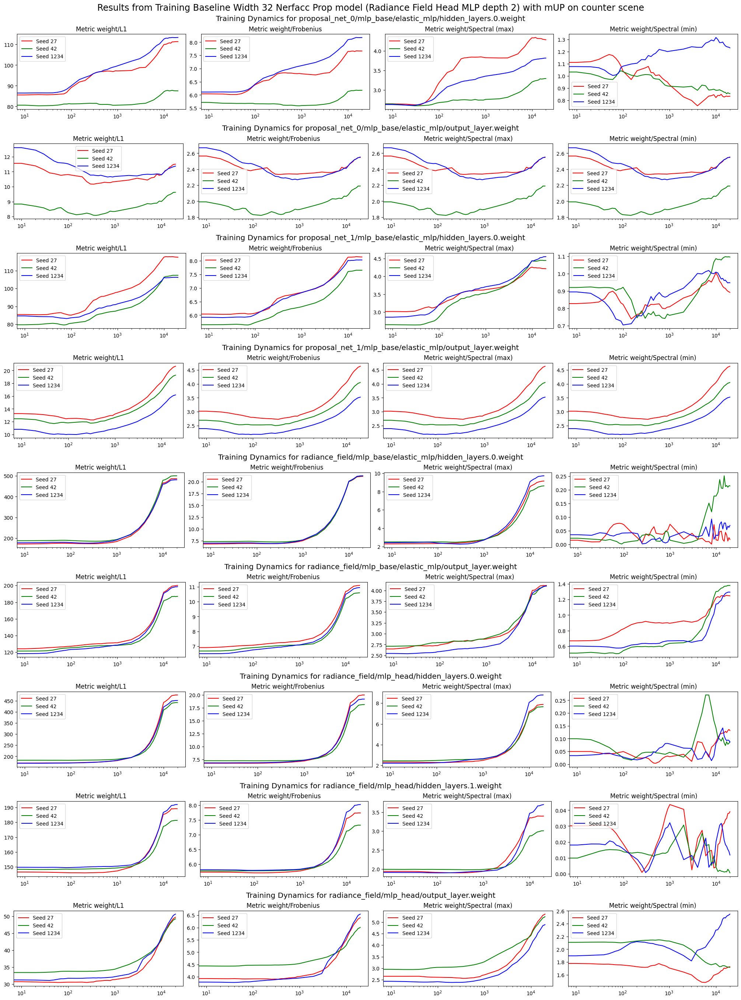

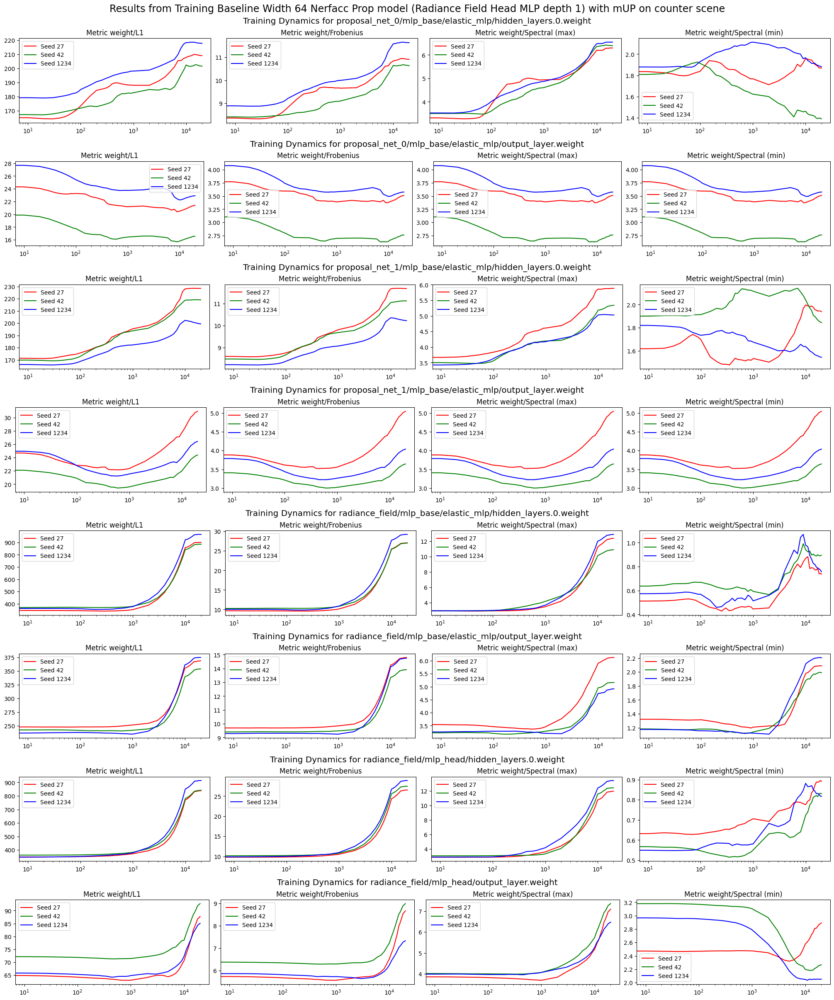

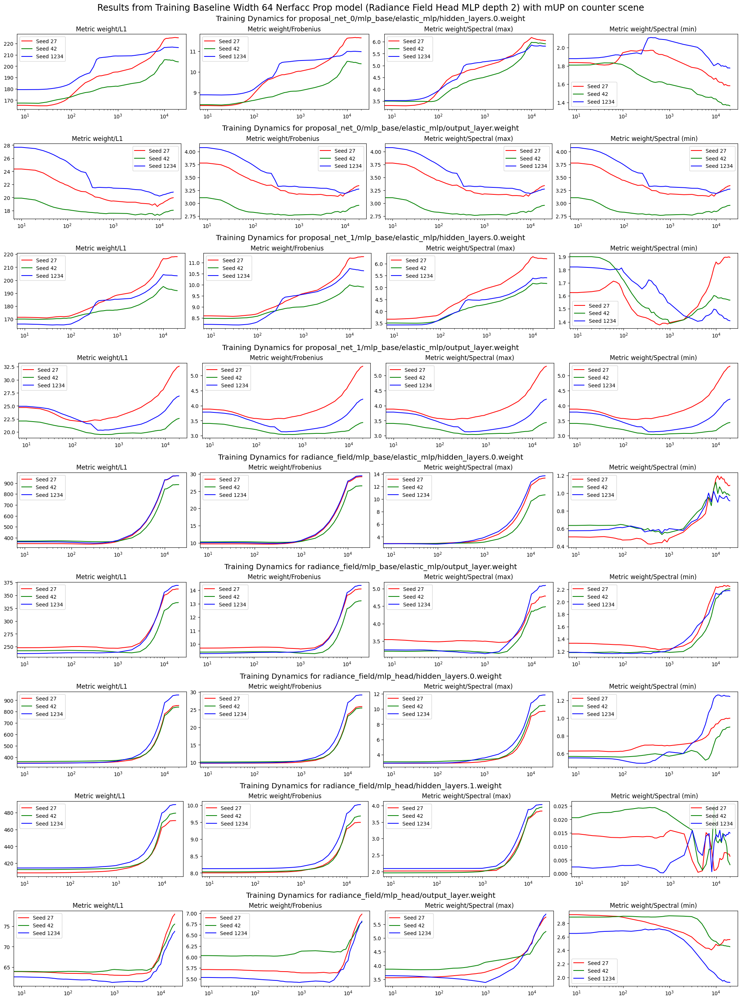

In [ ]:
cc = ColorConfig()
metric_types = [
    "weight/L1",
    "weight/Frobenius",
    "weight/Spectral (max)",
    "weight/Spectral (min)",
]

for scene, scene_group in df.groupby(by="dataset.scene"):
    for model_type, model_type_group in scene_group.groupby(by="model_type"):
        for hidden_dim, hidden_dim_group in model_type_group.groupby(by="hidden_dim"):
            for head_depth, head_depth_group in hidden_dim_group.groupby(
                by="radiance_field.head_depth"
            ):
                fig = plt.figure(
                    layout="constrained",
                    figsize=(
                        5 * len(metric_types),
                        3 * len(head_depth_group["module"].unique()),
                    ),
                )
                model_type_name = (
                    "Nerfacc Occ" if "occ" in model_type else "Nerfacc Prop"
                )
                fig.suptitle(
                    f"Results from Training Baseline Width {hidden_dim} {model_type_name} model (Radiance Field Head MLP depth {head_depth}) with mUP on {scene} scene",
                    fontsize="xx-large",
                )
                colors = ["r", "g", "b"]
                subfigs = fig.subfigures(
                    len(head_depth_group["module"].unique()), 1, wspace=0.07
                )
                for i, (module, module_group) in enumerate(
                    head_depth_group.query("width == @hidden_dim").groupby(by="module")
                ):
                    subfig = subfigs[i]
                    subfig.suptitle(
                        f"Training Dynamics for {module}", fontsize="x-large"
                    )
                    subplots = subfig.subplots(1, len(metric_types))
                    for j, metric_type in enumerate(metric_types):
                        ax = subplots[j]
                        for k, (seed, seed_group) in enumerate(
                            module_group.groupby(by="seed")
                        ):
                            ax.plot(
                                width_group["step"],
                                seed_group[f"{metric_type}"],
                                color=colors[k],
                                label=f"Seed {seed}",
                            )
                        ax.set_xscale("log")
                        ax.set_title(f"Metric {metric_type}")
                        ax.legend()
    break

In [ ]:
for hidden_dim, hidden_dim_group in model_type_group.groupby(by="hidden_dim"):
    for head_depth, head_depth_group in hidden_dim_group.groupby(
        by="radiance_field.head_depth"
    ):
        for i, (module, module_group) in enumerate(
            head_depth_group.query("width == @hidden_dim").groupby(by="module")
        ):
            break
        break
    break

In [ ]:
module_group

,step,width,module,sweep_id,run_id,model_type,exp_date,exp_name,project_name,dataset_name,...,grad/Frobenius,grad_scaled/Frobenius,weight/Spectral (max),weight_scaled/Spectral (max),grad/Spectral (max),grad_scaled/Spectral (max),weight/Spectral (min),weight_scaled/Spectral (min),grad/Spectral (min),grad_scaled/Spectral (min)
60,0,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,tln3m9xx,ngp_prop,2024-04-03-08-52-06,tln3m9xx,elastic-nerf,mipnerf360,...,NaN,NaN,1.798760,1.0,NaN,NaN,0.152194,1.0,NaN,NaN
124,10,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,tln3m9xx,ngp_prop,2024-04-03-08-52-06,tln3m9xx,elastic-nerf,mipnerf360,...,0.008459,1.0,1.784463,1.0,0.007868,1.0,0.151432,1.0,2.138769e-07,1.0
188,20,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,tln3m9xx,ngp_prop,2024-04-03-08-52-06,tln3m9xx,elastic-nerf,mipnerf360,...,0.017216,1.0,1.743131,1.0,0.013979,1.0,0.140298,1.0,8.200552e-08,1.0
252,30,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,tln3m9xx,ngp_prop,2024-04-03-08-52-06,tln3m9xx,elastic-nerf,mipnerf360,...,0.007989,1.0,1.698986,1.0,0.005354,1.0,0.118388,1.0,2.762361e-07,1.0
316,40,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,tln3m9xx,ngp_prop,2024-04-03-08-52-06,tln3m9xx,elastic-nerf,mipnerf360,...,0.009504,1.0,1.678940,1.0,0.008620,1.0,0.125015,1.0,1.215784e-06,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2492,16000,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,1g003jun,ngp_prop,2024-04-03-08-50-54,1g003jun,elastic-nerf,mipnerf360,...,0.039507,1.0,2.716816,1.0,0.035378,1.0,0.334691,1.0,3.161658e-05,1.0
2556,17000,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,1g003jun,ngp_prop,2024-04-03-08-50-54,1g003jun,elastic-nerf,mipnerf360,...,0.027030,1.0,2.731663,1.0,0.022338,1.0,0.334664,1.0,3.975530e-05,1.0
2620,18000,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,1g003jun,ngp_prop,2024-04-03-08-50-54,1g003jun,elastic-nerf,mipnerf360,...,0.046575,1.0,2.727311,1.0,0.043365,1.0,0.333890,1.0,2.719944e-05,1.0
2684,19000,8,proposal_net_0/mlp_base/elastic_mlp/hidden_lay...,2gc9i1ze,1g003jun,ngp_prop,2024-04-03-08-50-54,1g003jun,elastic-nerf,mipnerf360,...,0.030012,1.0,2.726763,1.0,0.025295,1.0,0.333097,1.0,1.774564e-05,1.0


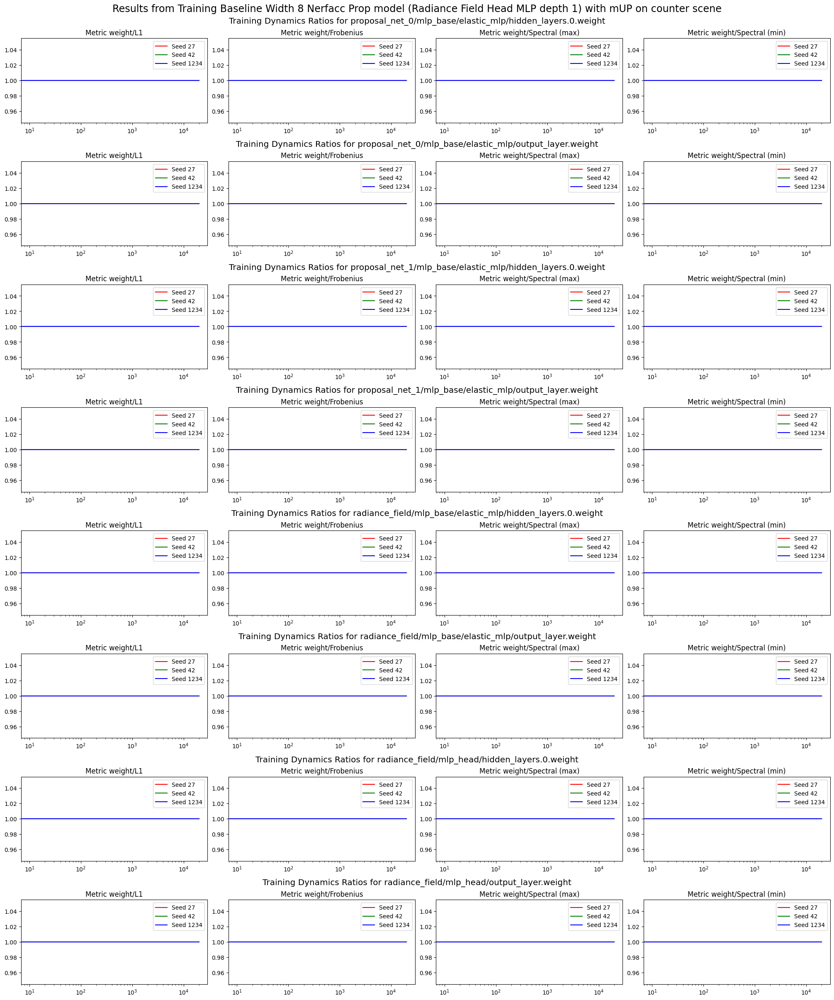

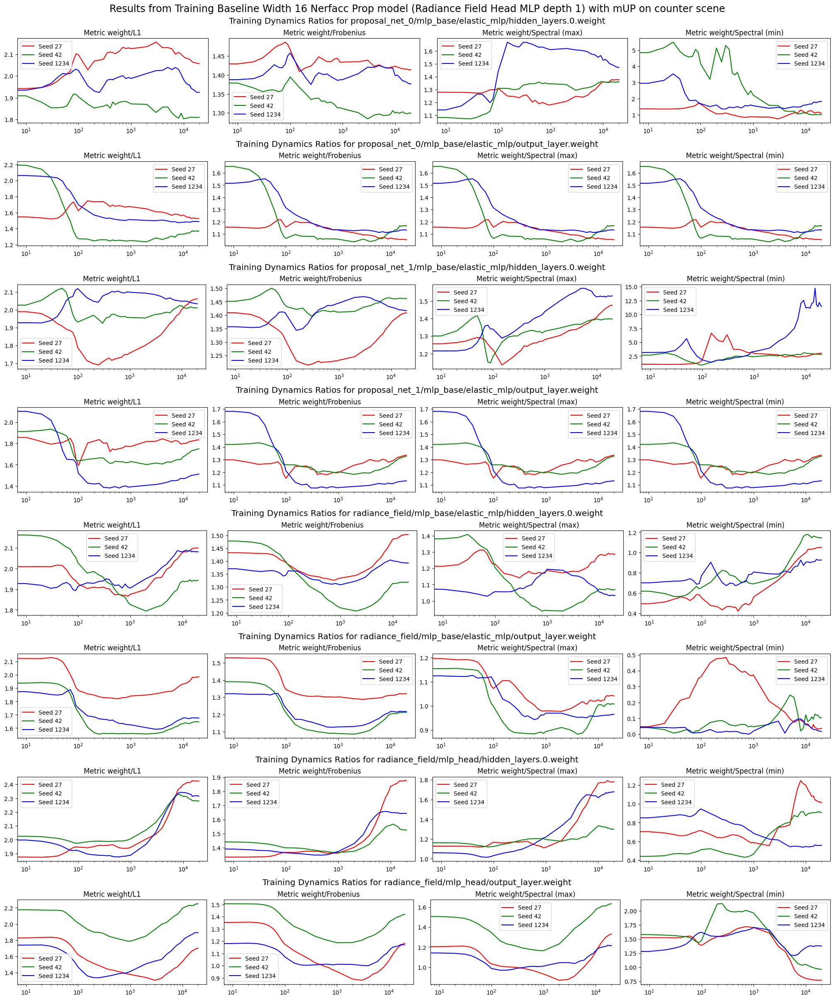

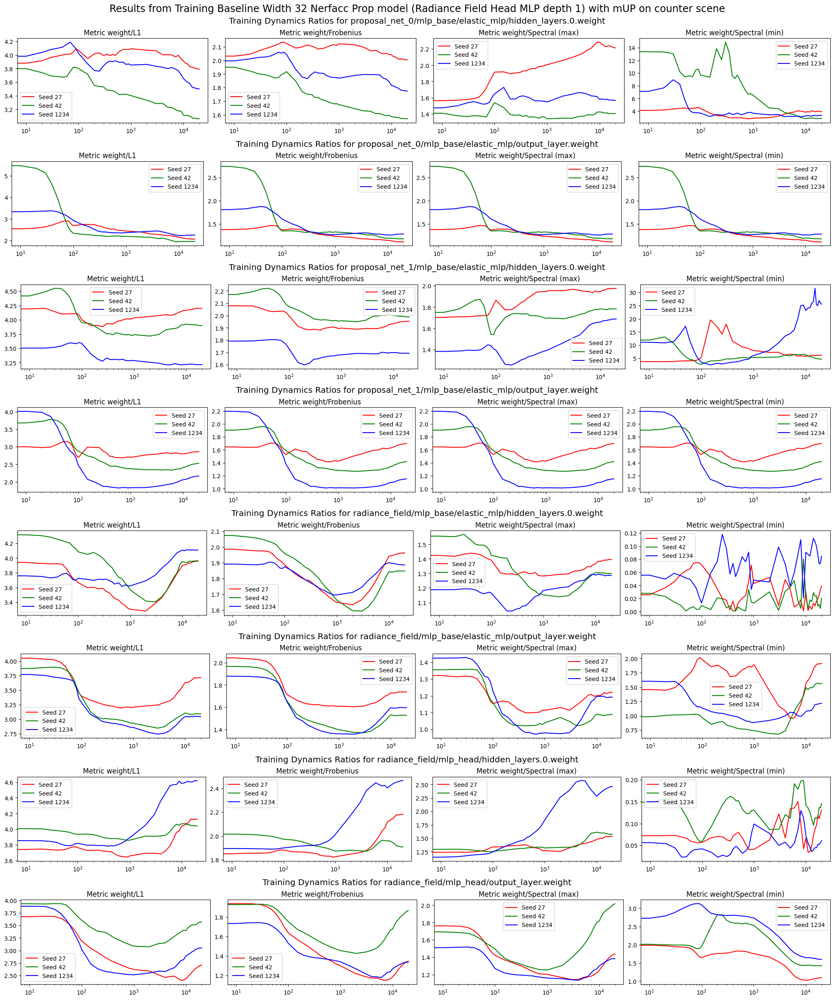

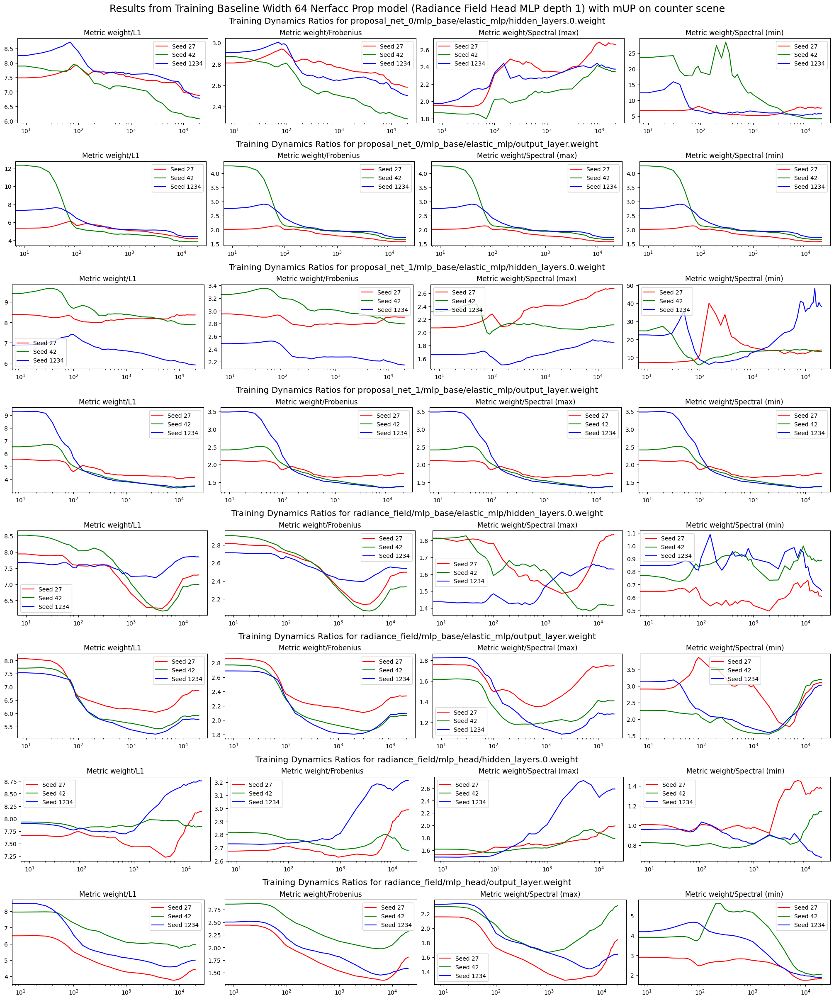

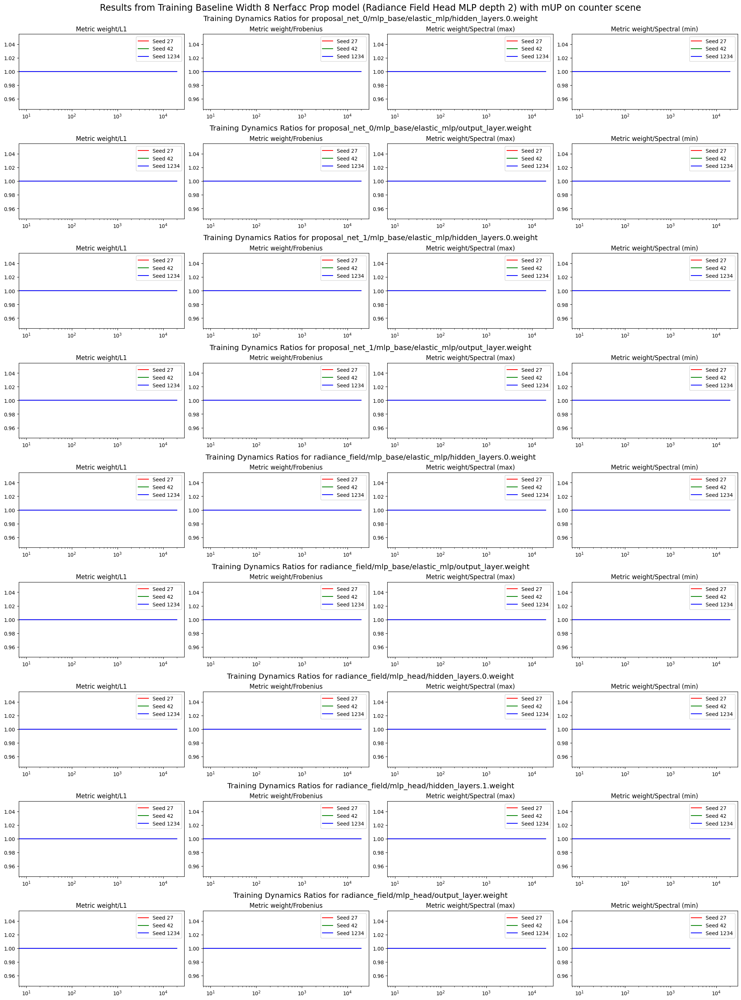

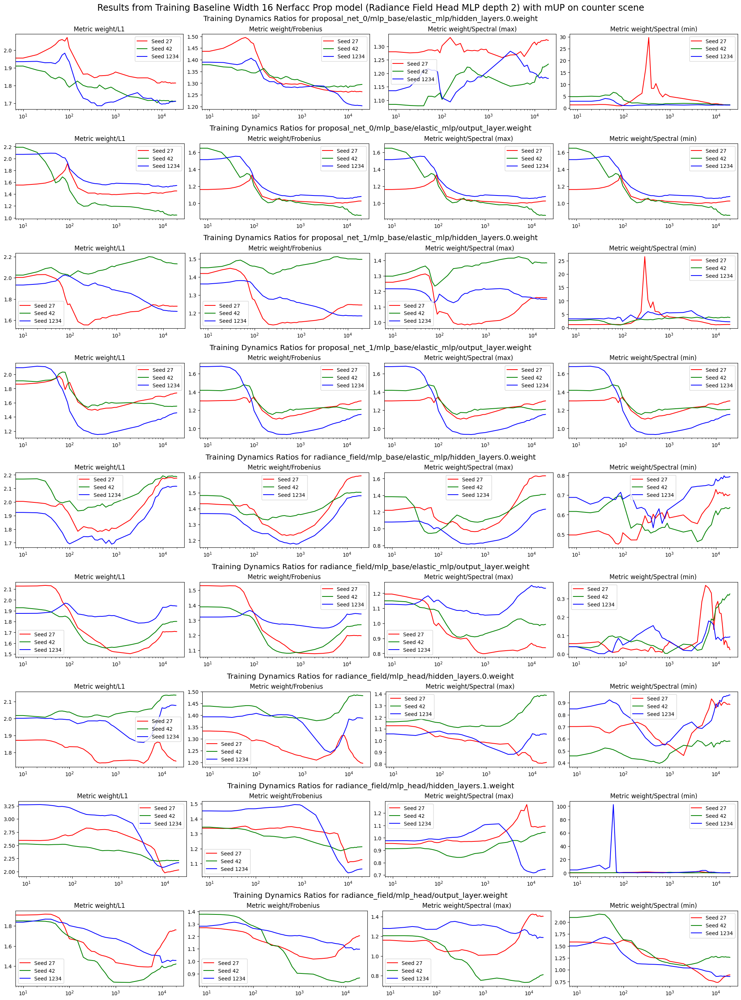

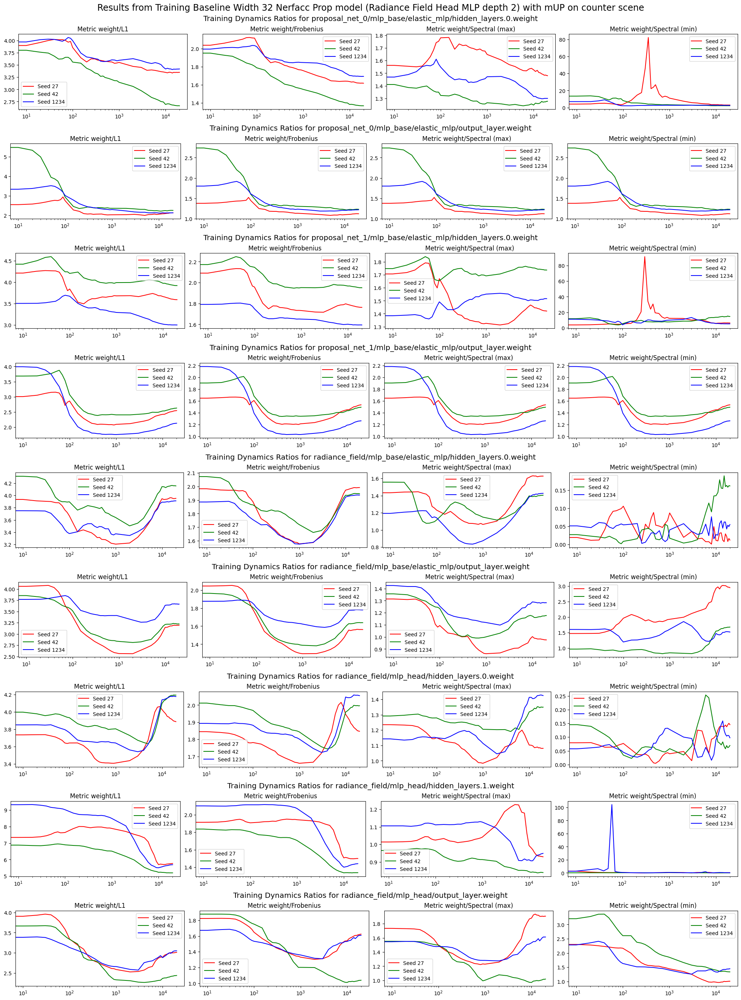

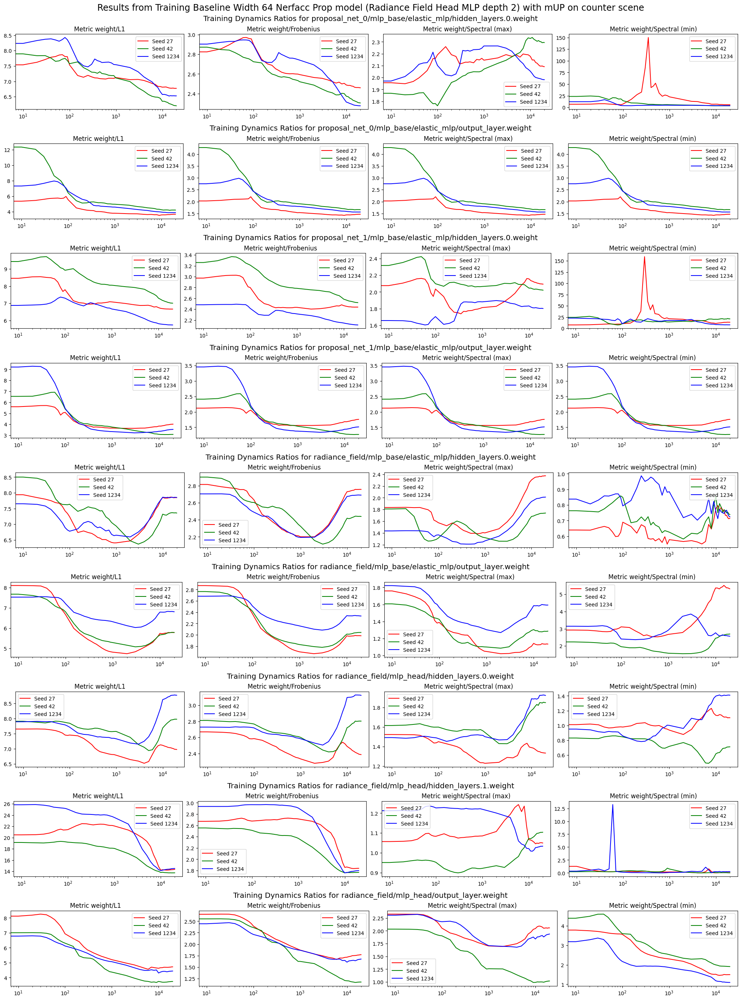

In [ ]:
metric_types = [
    "weight/L1",
    "weight/Frobenius",
    "weight/Spectral (max)",
    "weight/Spectral (min)",
]

for scene, scene_group in df.groupby(by="dataset.scene"):
    for model_type, model_type_group in scene_group.groupby(by="model_type"):
        for head_depth, head_depth_group in model_type_group.groupby(
            by="radiance_field.head_depth"
        ):
            base_psnrs = head_depth_group.query("hidden_dim == 8 and width == 8")
            for hidden_dim, hidden_dim_group in head_depth_group.groupby(
                by="hidden_dim"
            ):
                fig = plt.figure(
                    layout="constrained",
                    figsize=(
                        5 * len(metric_types),
                        3 * len(hidden_dim_group["module"].unique()),
                    ),
                )
                model_type_name = (
                    "Nerfacc Occ" if "occ" in model_type else "Nerfacc Prop"
                )
                fig.suptitle(
                    f"Results from Training Baseline Width {hidden_dim} {model_type_name} model (Radiance Field Head MLP depth {head_depth}) with mUP on {scene} scene",
                    fontsize="xx-large",
                )
                colors = ["r", "g", "b"]
                subfigs = fig.subfigures(
                    len(hidden_dim_group["module"].unique()), 1, wspace=0.07
                )
                for i, (module, module_group) in enumerate(
                    hidden_dim_group.query("width == @hidden_dim").groupby(by="module")
                ):
                    subfig = subfigs[i]
                    subfig.suptitle(
                        f"Training Dynamics Ratios for {module}", fontsize="x-large"
                    )
                    subplots = subfig.subplots(1, len(metric_types))
                    for j, metric_type in enumerate(metric_types):
                        ax = subplots[j]
                        for k, (seed, seed_group) in enumerate(
                            module_group.groupby(by="seed")
                        ):
                            base_psnrs_over_steps = base_psnrs.query(
                                "module == @module and seed == @seed"
                            )
                            assert len(base_psnrs_over_steps[f"{metric_type}"]) == len(
                                seed_group[f"{metric_type}"]
                            )
                            ax.plot(
                                width_group["step"],
                                np.divide(
                                    seed_group[f"{metric_type}"].to_numpy(),
                                    base_psnrs_over_steps[f"{metric_type}"].to_numpy(),
                                ),
                                color=colors[k],
                                label=f"Seed {seed}",
                            )
                        ax.set_xscale("log")
                        ax.set_title(f"Metric {metric_type}")
                        ax.legend()
    break

# Plot Weight scaling

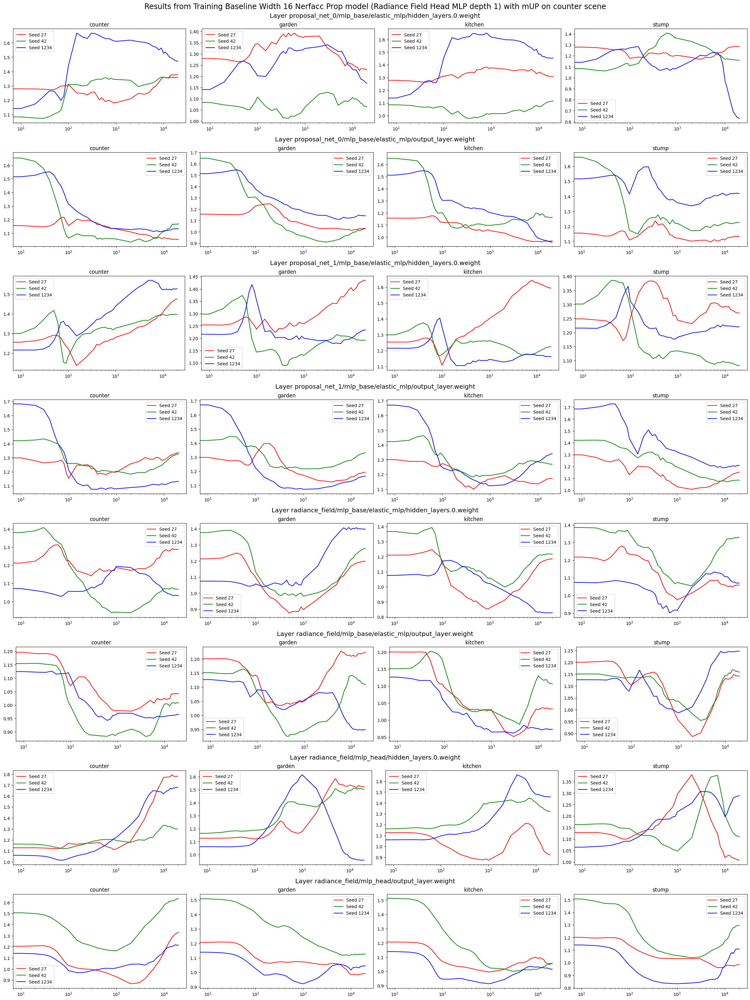

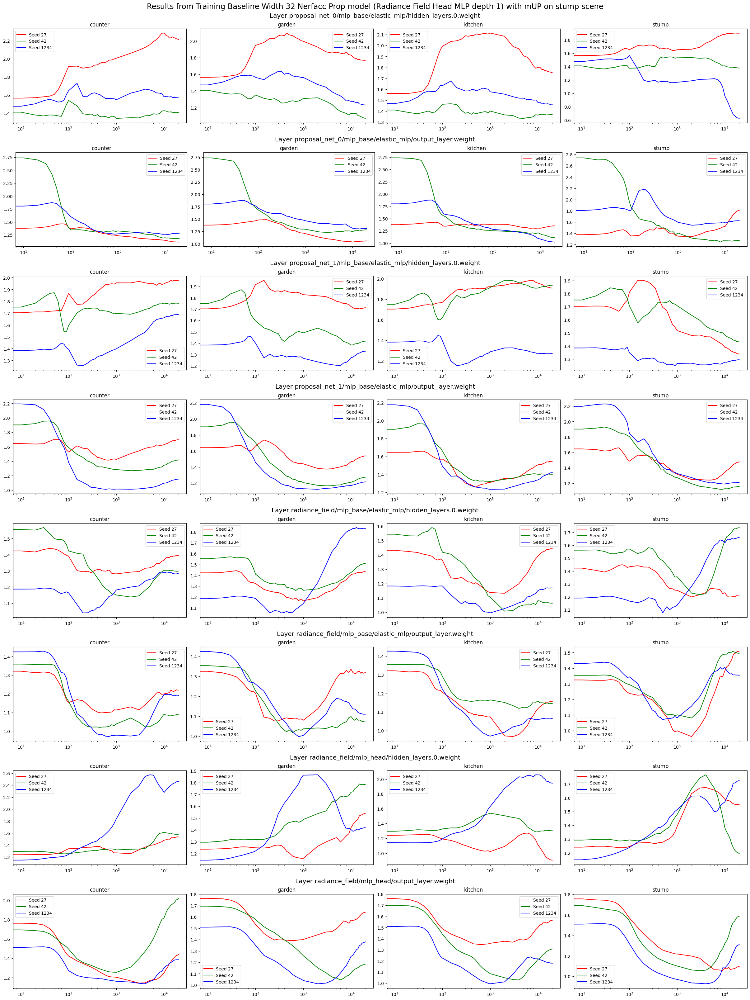

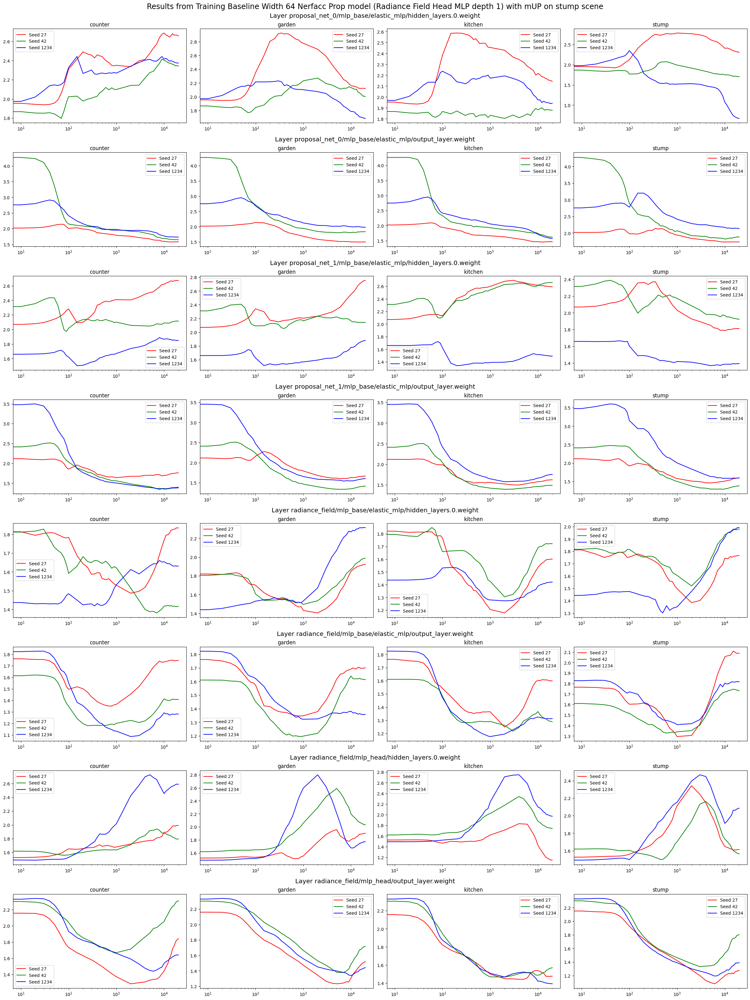

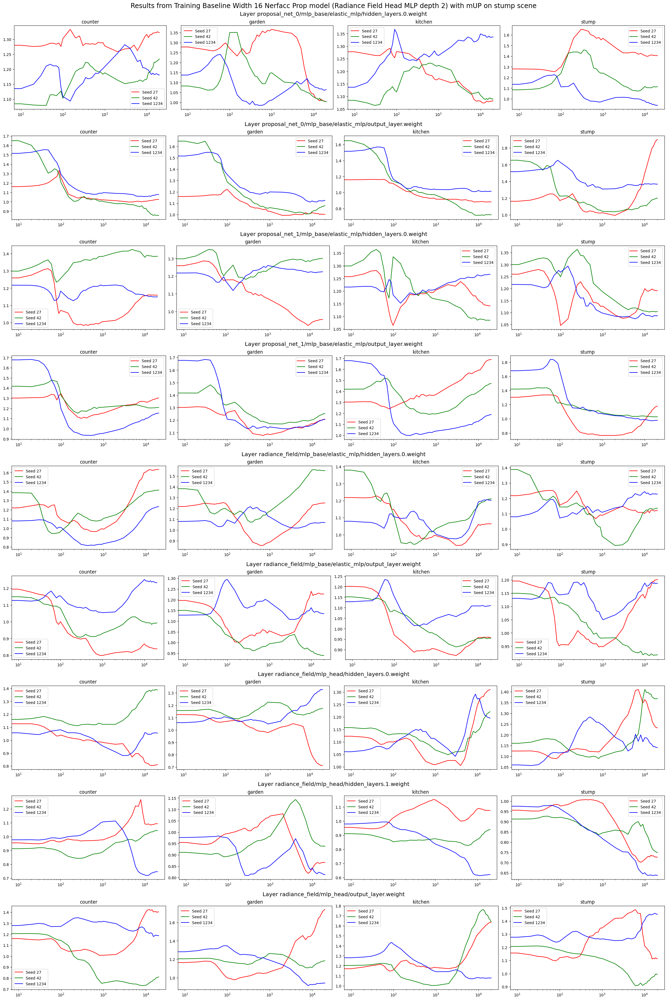

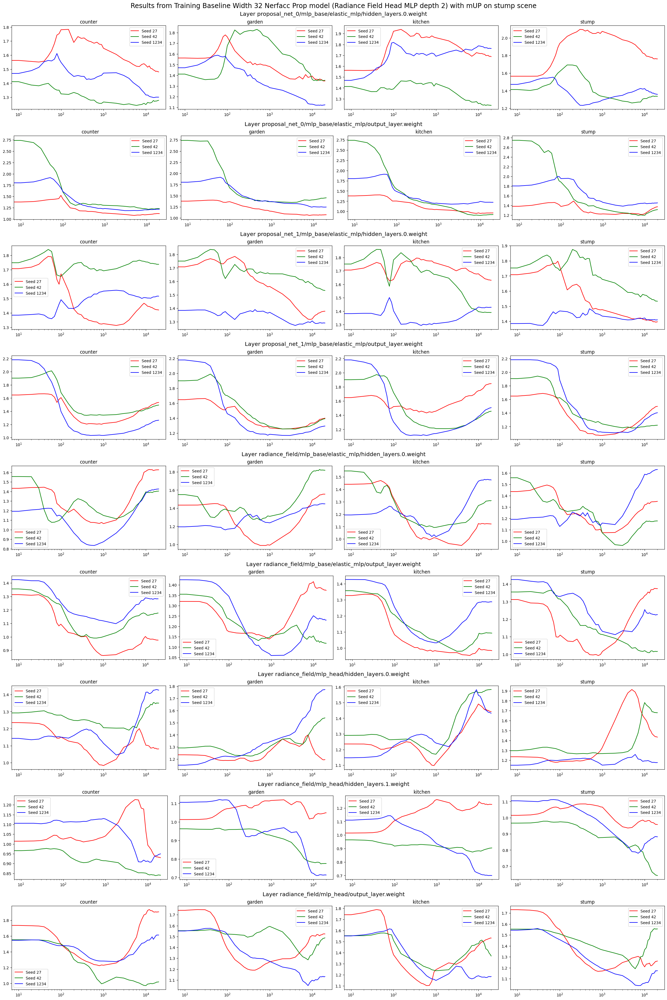

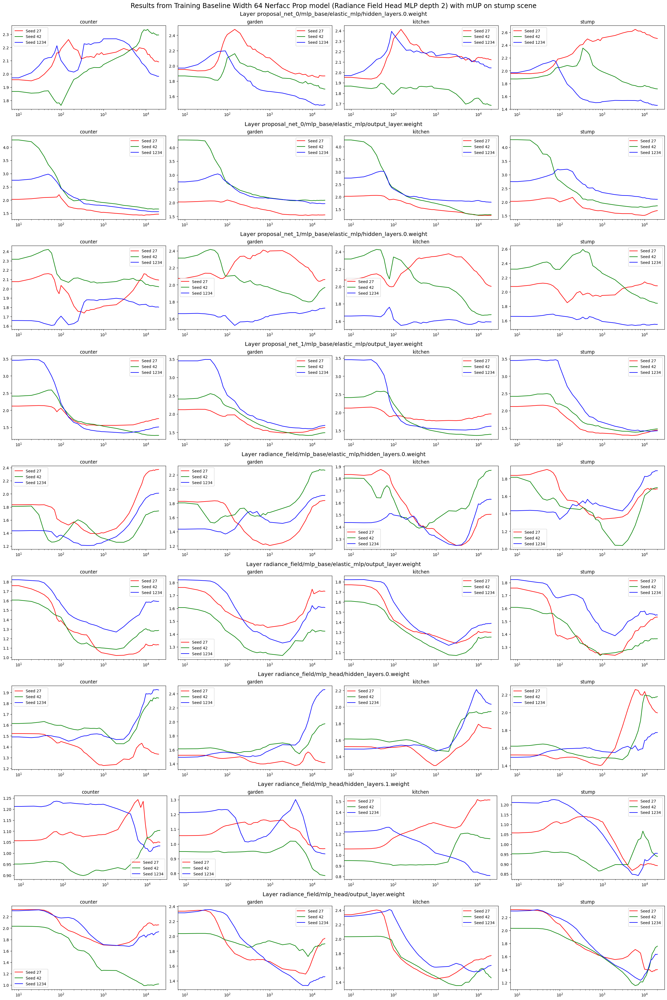

In [ ]:
metric_type = "weight/Spectral (max)"
colors = ["r", "g", "b"]

for model_type, model_type_group in df.groupby(by="model_type"):
    for head_depth, head_depth_group in model_type_group.groupby(
        by="radiance_field.head_depth"
    ):
        base_psnrs = head_depth_group.query("hidden_dim == 8 and width == 8")
        for hidden_dim, hidden_dim_group in head_depth_group.groupby(by="hidden_dim"):
            if hidden_dim == 8:
                # Don't plot 8 since we're computing the ratio wrt 8 so it'll just be constant.
                continue

            fig = plt.figure(
                layout="constrained",
                figsize=(
                    6 * len(df["dataset.scene"].unique()),
                    4 * len(hidden_dim_group["module"].unique()),
                ),
            )
            model_type_name = "Nerfacc Occ" if "occ" in model_type else "Nerfacc Prop"
            fig.suptitle(
                f"Results from Training Baseline Width {hidden_dim} {model_type_name} model (Radiance Field Head MLP depth {head_depth}) with mUP on {scene} scene",
                fontsize="xx-large",
            )
            subfigs = fig.subfigures(
                len(hidden_dim_group["module"].unique()), 1, wspace=0.07
            )

            for i, (module, module_group) in enumerate(
                hidden_dim_group.query("width == @hidden_dim").groupby(by="module")
            ):
                subfig = subfigs[i]
                subfig.suptitle(f"Layer {module}", fontsize="x-large")
                subplots = subfig.subplots(1, len(df["dataset.scene"].unique()))
                for j, (scene, scene_group) in enumerate(
                    module_group.groupby(by="dataset.scene")
                ):
                    ax = subplots[j]
                    for k, (seed, seed_group) in enumerate(
                        scene_group.groupby(by="seed")
                    ):
                        base_psnrs_over_steps = base_psnrs.query(
                            "module == @module and seed == @seed"
                        )
                        base_psnrs_over_steps = base_psnrs_over_steps[
                            base_psnrs_over_steps["dataset.scene"] == scene
                        ]
                        assert len(base_psnrs_over_steps[f"{metric_type}"]) == len(
                            seed_group[f"{metric_type}"]
                        )
                        ax.plot(
                            width_group["step"],
                            np.divide(
                                seed_group[f"{metric_type}"].to_numpy(),
                                base_psnrs_over_steps[f"{metric_type}"].to_numpy(),
                            ),
                            color=colors[k],
                            label=f"Seed {seed}",
                        )
                    ax.set_xscale("log")
                    ax.set_title(f"{scene}")
                    ax.legend()
            fig.show()

In [ ]:
print(len(width_group["step"]))
print(len(seed_group[f"{metric_type}"]))
print(len(base_psnrs_over_steps[f"{metric_type}"]))

43
43
43


# Plot Grad Scaling

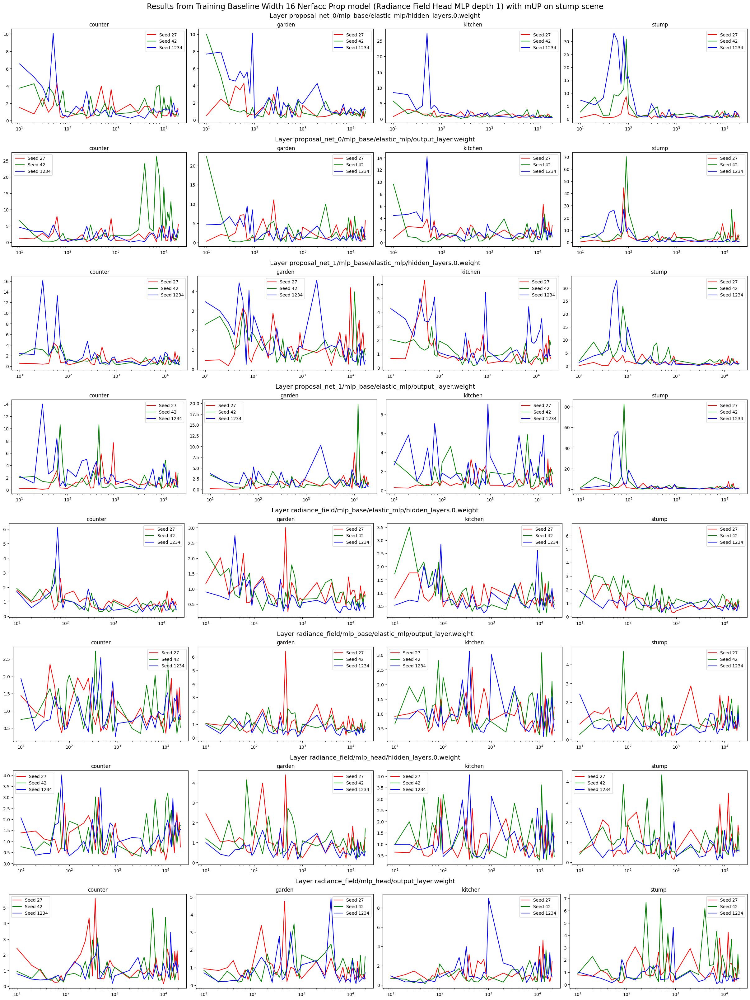

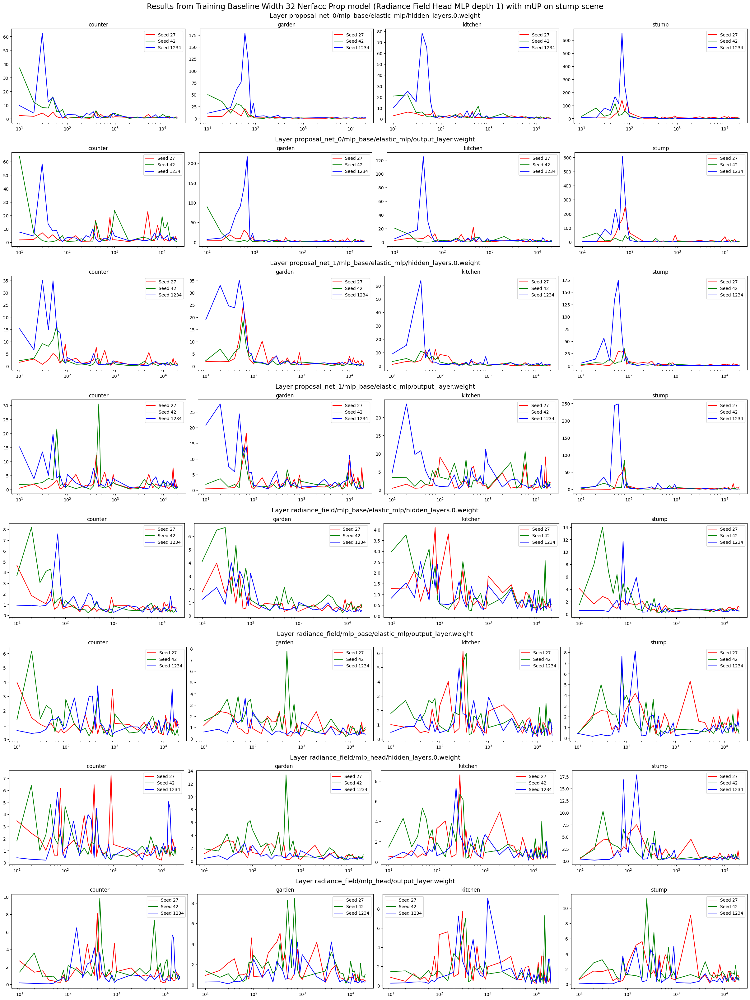

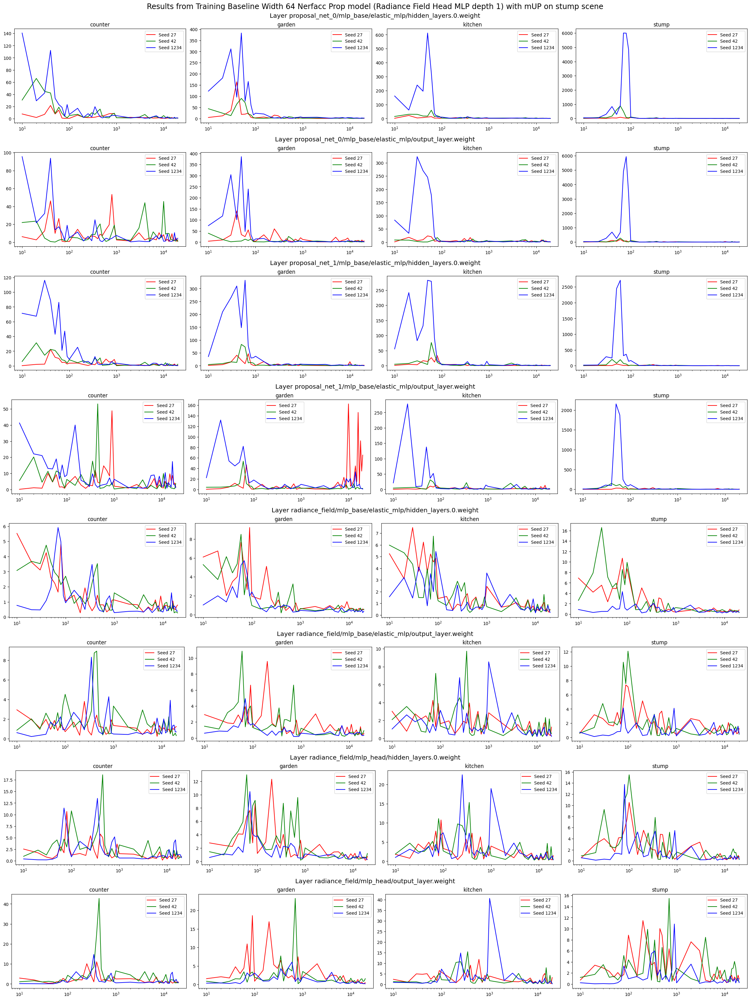

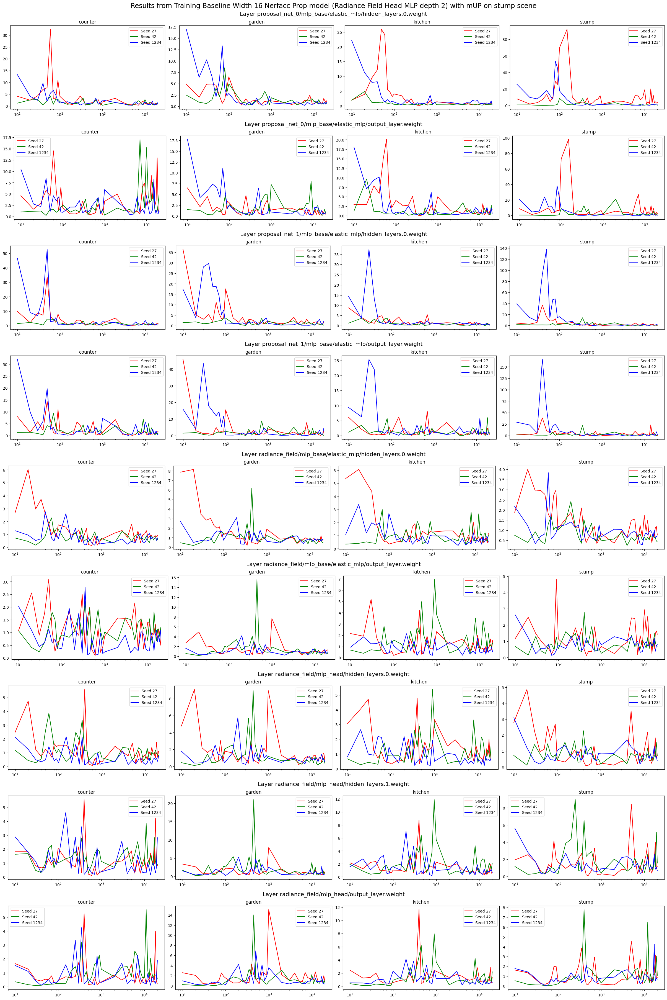

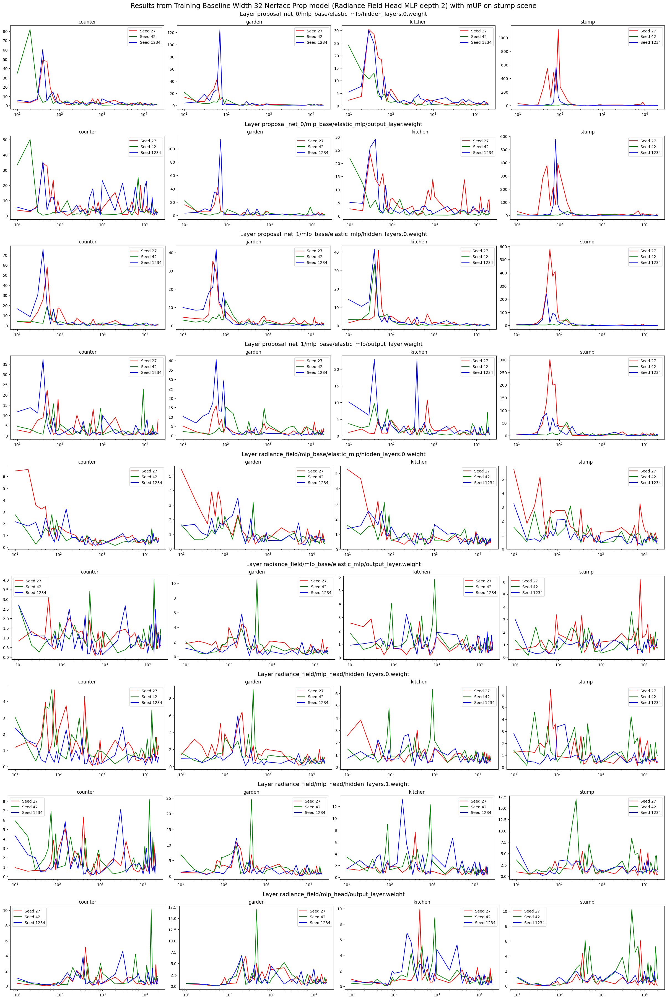

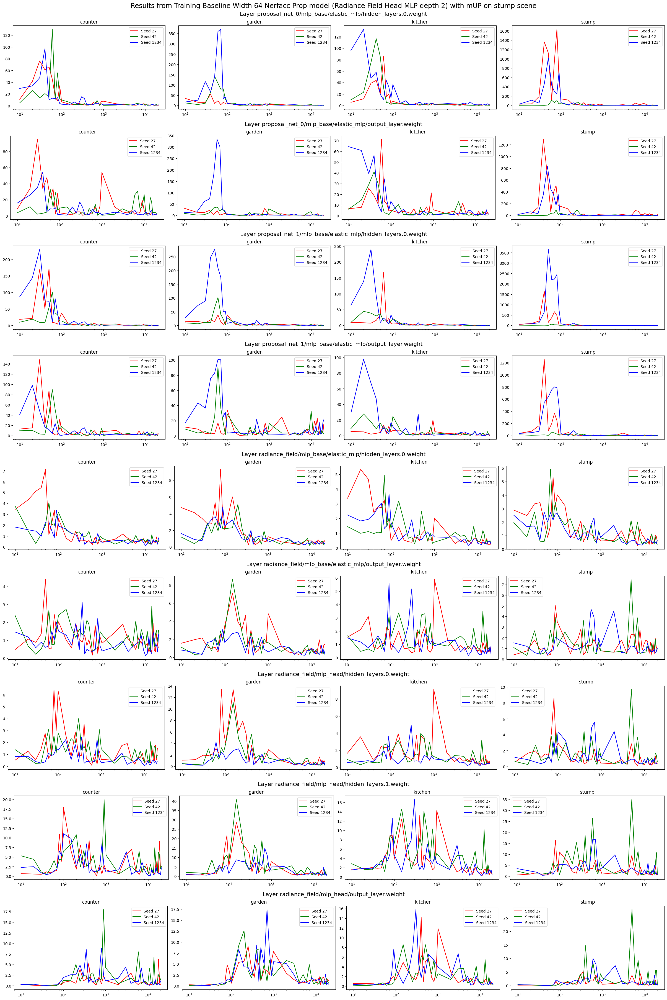

In [ ]:
metric_type = "grad/Spectral (max)"
colors = ["r", "g", "b"]

for model_type, model_type_group in df.groupby(by="model_type"):
    for head_depth, head_depth_group in model_type_group.groupby(
        by="radiance_field.head_depth"
    ):
        base_psnrs = head_depth_group.query("hidden_dim == 8 and width == 8")
        for hidden_dim, hidden_dim_group in head_depth_group.groupby(by="hidden_dim"):
            if hidden_dim == 8:
                # Don't plot 8 since we're computing the ratio wrt 8 so it'll just be constant.
                continue

            fig = plt.figure(
                layout="constrained",
                figsize=(
                    6 * len(df["dataset.scene"].unique()),
                    4 * len(hidden_dim_group["module"].unique()),
                ),
            )
            model_type_name = "Nerfacc Occ" if "occ" in model_type else "Nerfacc Prop"
            fig.suptitle(
                f"Results from Training Baseline Width {hidden_dim} {model_type_name} model (Radiance Field Head MLP depth {head_depth}) with mUP on {scene} scene",
                fontsize="xx-large",
            )
            subfigs = fig.subfigures(
                len(hidden_dim_group["module"].unique()), 1, wspace=0.07
            )

            for i, (module, module_group) in enumerate(
                hidden_dim_group.query("width == @hidden_dim").groupby(by="module")
            ):
                subfig = subfigs[i]
                subfig.suptitle(f"Layer {module}", fontsize="x-large")
                subplots = subfig.subplots(1, len(df["dataset.scene"].unique()))
                for j, (scene, scene_group) in enumerate(
                    module_group.groupby(by="dataset.scene")
                ):
                    ax = subplots[j]
                    for k, (seed, seed_group) in enumerate(
                        scene_group.groupby(by="seed")
                    ):
                        base_psnrs_over_steps = base_psnrs.query(
                            "module == @module and seed == @seed"
                        )
                        base_psnrs_over_steps = base_psnrs_over_steps[
                            base_psnrs_over_steps["dataset.scene"] == scene
                        ]
                        assert len(base_psnrs_over_steps[f"{metric_type}"]) == len(
                            seed_group[f"{metric_type}"]
                        )
                        ax.plot(
                            width_group["step"],
                            np.divide(
                                seed_group[f"{metric_type}"].to_numpy(),
                                base_psnrs_over_steps[f"{metric_type}"].to_numpy(),
                            ),
                            color=colors[k],
                            label=f"Seed {seed}",
                        )
                    ax.set_xscale("log")
                    ax.set_title(f"{scene}")
                    ax.legend()
            fig.show()